In [1]:
# --- Importing Libraries ---
import numpy as np
import pandas as pd
import folium
import matplotlib.pyplot as plt
#import pandas_profiling
import seaborn as sns
import warnings
import os
import yellowbrick
import geopandas as gpd
import scipy.cluster.hierarchy as shc
import matplotlib.patches as patches
from folium import Choropleth, Popup
from matplotlib.patches import Rectangle
from pywaffle import Waffle
from math import isnan
from random import sample
from numpy.random import uniform
from sklearn.neighbors import NearestNeighbors
from sklearn.impute import KNNImputer
from sklearn.preprocessing import StandardScaler
from sklearn.decomposition import PCA
from sklearn.cluster import KMeans, DBSCAN, AgglomerativeClustering
from sklearn.metrics import davies_bouldin_score, silhouette_score, calinski_harabasz_score, silhouette_samples
from yellowbrick.cluster import KElbowVisualizer, SilhouetteVisualizer
from yellowbrick.style import set_palette
from yellowbrick.contrib.wrapper import wrap
import scipy.cluster.hierarchy as shc
from scipy.cluster.hierarchy import fcluster
from matplotlib.colors import LinearSegmentedColormap
from sklearn.preprocessing import LabelEncoder

# --- Libraries Settings ---
warnings.filterwarnings('ignore')
sns.set_style('whitegrid')
plt.rcParams['figure.dpi'] = 400
sns.set(rc = {'axes.facecolor': '#FBFBFB', 'figure.facecolor': '#FBFBFB'})
class clr:
    start = '\033[93m'+'\033[1m'
    color = '\033[93m'
    end = '\033[0m'

# Read Data

In [3]:
# Membaca file CSV
file_path = r"D:\Kuliah IPB\02 Kuliah\03 Semester 3\Pemodelan Klasifikasi\P1\2023-20240820T092137Z-001\2023\csv\Modul KP (Konsumsi Pengeluaran)\2023 Maret JABAR - SUSENAS KP BP 4.3.csv"
kp_raw = pd.read_csv(file_path, index_col=0)
kp_raw

,URUT,R101,R102,R105,R301,FOOD,NONFOOD,EXPEND,KAPITA,KALORI_KAP,PROTE_KAP,LEMAK_KAP,KARBO_KAP,WERT,WEIND,PSU,SSU,WI1,WI2
0,500001,32,7,2,4,2.660400e+06,2.304033e+06,4.964433e+06,1.241108e+06,2365.173362,67.130240,43.222388,352.985743,454.889101,1819.556406,12448,123442,12435,123427
1,500002,32,72,1,2,1.108714e+06,5.251667e+05,1.633881e+06,8.169405e+05,2611.639071,69.091893,30.118243,471.997686,172.376821,344.753642,31373,311039,31360,311024
2,500003,32,6,2,3,2.413886e+06,1.398333e+06,3.812219e+06,1.270740e+06,2526.510476,68.742619,58.517619,360.456190,241.578661,724.735983,12092,119908,12079,119893
3,500004,32,72,1,7,7.770000e+06,4.313333e+06,1.208333e+07,1.726190e+06,3655.854810,141.502615,119.460426,454.939531,93.673563,655.714941,31135,308689,31122,308674
4,500005,32,77,1,3,4.932557e+06,4.621975e+07,5.115231e+07,1.705077e+07,2330.987934,78.533354,53.141607,254.846110,122.217556,366.652669,33988,336798,33975,336783
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
25885,525886,32,75,1,4,7.554857e+06,8.603709e+06,1.615857e+07,4.039642e+06,2227.460536,81.321857,45.307661,306.247218,1229.081801,4916.327203,33078,327818,33065,327803
25886,525887,32,16,1,5,3.572143e+06,5.581333e+06,9.153476e+06,1.830695e+06,1711.114357,68.675743,46.467657,212.155300,531.663859,2658.319297,22856,226787,22843,226772
25887,525888,32,16,1,5,2.878371e+06,2.718500e+06,5.596871e+06,1.119374e+06,1621.781673,48.896660,45.535567,215.970774,1479.965203,7399.826013,23150,229731,23137,229716
25888,525889,32,73,1,4,1.719857e+06,3.712000e+06,5.431857e+06,1.357964e+06,1451.510459,40.395735,41.464533,209.007286,1645.203314,6580.813255,31453,311836,31440,311821


In [4]:
kp_raw.info()

<class 'pandas.core.frame.DataFrame'>
Index: 25890 entries, 0 to 25889
Data columns (total 19 columns):
 #   Column      Non-Null Count  Dtype  
---  ------      --------------  -----  
 0   URUT        25890 non-null  int64  
 1   R101        25890 non-null  int64  
 2   R102        25890 non-null  int64  
 3   R105        25890 non-null  int64  
 4   R301        25890 non-null  int64  
 5   FOOD        25890 non-null  float64
 6   NONFOOD     25890 non-null  float64
 7   EXPEND      25890 non-null  float64
 8   KAPITA      25890 non-null  float64
 9   KALORI_KAP  25890 non-null  float64
 10  PROTE_KAP   25890 non-null  float64
 11  LEMAK_KAP   25890 non-null  float64
 12  KARBO_KAP   25890 non-null  float64
 13  WERT        25890 non-null  float64
 14  WEIND       25890 non-null  float64
 15  PSU         25890 non-null  int64  
 16  SSU         25890 non-null  int64  
 17  WI1         25890 non-null  int64  
 18  WI2         25890 non-null  int64  
dtypes: float64(10), int64(9)
memor

In [5]:
# Stat Deskriptif
stat_desk = kp_raw.describe()
stat_desk

,URUT,R101,R102,R105,R301,FOOD,NONFOOD,EXPEND,KAPITA,KALORI_KAP,PROTE_KAP,LEMAK_KAP,KARBO_KAP,WERT,WEIND,PSU,SSU,WI1,WI2
count,25890.000000,25890.0,25890.000000,25890.000000,25890.00000,2.589000e+04,2.589000e+04,2.589000e+04,2.589000e+04,25890.000000,25890.000000,25890.000000,25890.000000,25890.000000,25890.000000,25890.000000,25890.000000,25890.000000,25890.000000
mean,512945.500000,32.0,28.203978,1.345191,3.27107,2.608072e+06,2.846429e+06,5.454501e+06,1.855078e+06,2316.151421,69.951890,54.063653,331.602731,533.345919,1971.357281,19759.606450,195948.791348,19746.606450,195933.791348
std,7473.943571,0.0,30.150396,0.475440,1.36662,1.886207e+06,5.634584e+06,6.877107e+06,2.372986e+06,678.408698,24.822145,23.102986,103.202253,526.967901,2519.899441,10421.718094,103308.875015,10421.718094,103308.875015
min,500001.000000,32.0,1.000000,1.000000,1.00000,1.303671e+05,5.833333e+04,3.352024e+05,2.154708e+05,1001.597524,18.515714,9.800786,67.264617,2.145312,2.930102,22.000000,96.000000,9.000000,81.000000
25%,506473.250000,32.0,6.000000,1.000000,2.00000,1.433904e+06,8.995917e+05,2.454899e+06,7.892226e+05,1851.193139,53.093614,38.843701,260.459712,170.616475,438.129852,11281.000000,111888.250000,11268.000000,111873.250000
50%,512945.500000,32.0,13.000000,1.000000,3.00000,2.126700e+06,1.486733e+06,3.725250e+06,1.207729e+06,2208.058798,65.386579,49.711531,317.523402,383.223899,1168.559615,20775.000000,206113.500000,20762.000000,206098.500000
75%,519417.750000,32.0,72.000000,2.000000,4.00000,3.163232e+06,2.741938e+06,5.916417e+06,1.956817e+06,2669.314071,81.436839,64.064508,384.694116,716.808224,2497.645502,30398.000000,301411.750000,30385.000000,301396.750000
max,525890.000000,32.0,79.000000,2.000000,13.00000,2.805857e+07,3.208442e+08,3.295314e+08,1.008019e+08,4499.798750,311.675341,300.225954,834.646786,3821.022809,37770.547135,34485.000000,341775.000000,34472.000000,341760.000000


In [6]:
# Fitur FoodKapita
kp_raw['FOOD_KAPITA'] = kp_raw['FOOD'] / kp_raw['R301']
kp_raw.head()


,URUT,R101,R102,R105,R301,FOOD,NONFOOD,EXPEND,KAPITA,KALORI_KAP,PROTE_KAP,LEMAK_KAP,KARBO_KAP,WERT,WEIND,PSU,SSU,WI1,WI2,FOOD_KAPITA
0,500001,32,7,2,4,2.660400e+06,2.304033e+06,4.964433e+06,1.241108e+06,2365.173362,67.130240,43.222388,352.985743,454.889101,1819.556406,12448,123442,12435,123427,6.651000e+05
1,500002,32,72,1,2,1.108714e+06,5.251667e+05,1.633881e+06,8.169405e+05,2611.639071,69.091893,30.118243,471.997686,172.376821,344.753642,31373,311039,31360,311024,5.543571e+05
2,500003,32,6,2,3,2.413886e+06,1.398333e+06,3.812219e+06,1.270740e+06,2526.510476,68.742619,58.517619,360.456190,241.578661,724.735983,12092,119908,12079,119893,8.046286e+05
3,500004,32,72,1,7,7.770000e+06,4.313333e+06,1.208333e+07,1.726190e+06,3655.854810,141.502615,119.460426,454.939531,93.673563,655.714941,31135,308689,31122,308674,1.110000e+06
4,500005,32,77,1,3,4.932557e+06,4.621975e+07,5.115231e+07,1.705077e+07,2330.987934,78.533354,53.141607,254.846110,122.217556,366.652669,33988,336798,33975,336783,1.644186e+06


In [7]:
kp_raw["FOOD_KAPITA"].describe()

count    2.589000e+04
mean     8.642823e+05
std      6.054680e+05
min      1.171429e+05
25%      4.748464e+05
50%      6.792857e+05
75%      1.041429e+06
max      8.175000e+06
Name: FOOD_KAPITA, dtype: float64

Pada Provinsi Jawa Barat, Garis Kemiskinan Makanan (GKM) sebesar 367.040,00 sedangkan pada tingkat nasional GKM sebesar 448240. Sehingga akan kita bagi pendapatan terhadap makan dengan GKM untuk mendapatkan kriteria apakah dia termasuk rentan terhadap pangan. Kita akan mulai membuat simulasi untuk 2 kondisi dimana: 1) Simulasi 1: Kode akan dibuat dalam bentuk 0 = "Rentan Pangan", 1 = "Tahan Pangan" dan; 2) Simulasi 2: Kode akan dibuat dalam bentuk 0 = "Sangat Rentan", 1 = "Rentan" dan 2 = "Tidak Rentan"

## Simulasi Kondisi 1

In [8]:
# Pemberian Label GKM
kp_raw['FOOD_LABEL'] = np.where(kp_raw['FOOD_KAPITA'] < 367040, 1, 0)
kp_raw.head()

,URUT,R101,R102,R105,R301,FOOD,NONFOOD,EXPEND,KAPITA,KALORI_KAP,...,LEMAK_KAP,KARBO_KAP,WERT,WEIND,PSU,SSU,WI1,WI2,FOOD_KAPITA,FOOD_LABEL
0,500001,32,7,2,4,2.660400e+06,2.304033e+06,4.964433e+06,1.241108e+06,2365.173362,...,43.222388,352.985743,454.889101,1819.556406,12448,123442,12435,123427,6.651000e+05,0
1,500002,32,72,1,2,1.108714e+06,5.251667e+05,1.633881e+06,8.169405e+05,2611.639071,...,30.118243,471.997686,172.376821,344.753642,31373,311039,31360,311024,5.543571e+05,0
2,500003,32,6,2,3,2.413886e+06,1.398333e+06,3.812219e+06,1.270740e+06,2526.510476,...,58.517619,360.456190,241.578661,724.735983,12092,119908,12079,119893,8.046286e+05,0
3,500004,32,72,1,7,7.770000e+06,4.313333e+06,1.208333e+07,1.726190e+06,3655.854810,...,119.460426,454.939531,93.673563,655.714941,31135,308689,31122,308674,1.110000e+06,0
4,500005,32,77,1,3,4.932557e+06,4.621975e+07,5.115231e+07,1.705077e+07,2330.987934,...,53.141607,254.846110,122.217556,366.652669,33988,336798,33975,336783,1.644186e+06,0


In [9]:
# Hitung persen proporsi 0 dan 1
prop_table = kp_raw['FOOD_LABEL'].replace({0: 'Tahan Pangan', 1: 'Miskin Pangan'}).value_counts(normalize=True) * 100
prop_df = prop_table.reset_index()
prop_df.columns = ['Kategori', 'Percentage']

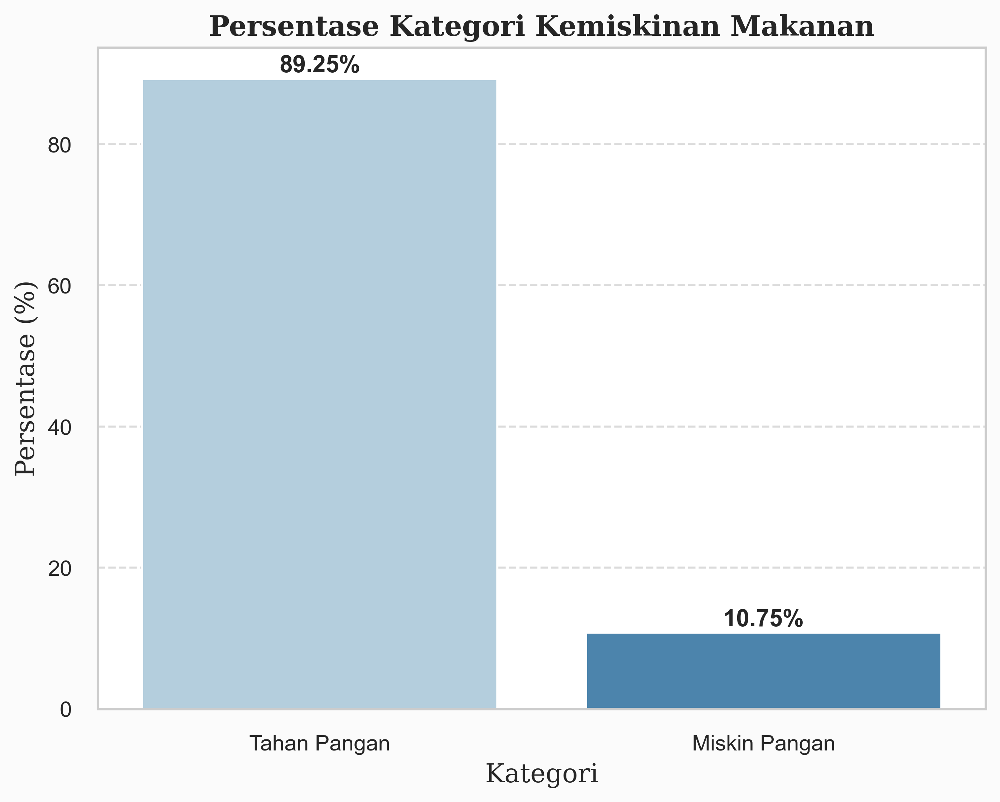

In [10]:
# Plotting proporsi 0 dan 1
plt.figure(figsize=(8, 6))
sns.set_style('whitegrid')
sns.barplot(x='Kategori', y='Percentage', data=prop_df, palette='Blues', saturation=0.7)

for i in range(len(prop_df)):
    plt.text(i, prop_df['Percentage'].iloc[i] + 1, f"{prop_df['Percentage'].iloc[i]:.2f}%", ha='center', fontsize=12, fontweight='bold')
plt.title('Persentase Kategori Kemiskinan Makanan', fontsize=14, fontweight='bold', family='serif')
plt.xlabel('Kategori', fontsize=13, family='serif')
plt.ylabel('Persentase (%)', fontsize=13, family='serif')
plt.grid(True, axis='y', linestyle='--', alpha=0.7)
plt.show()

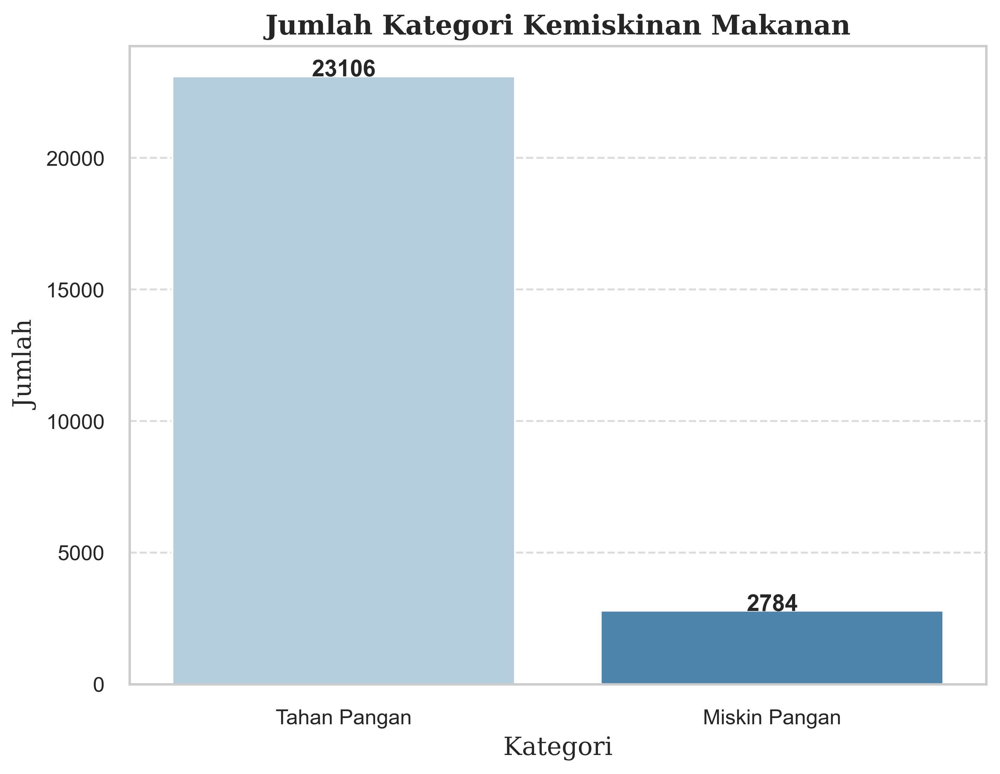

In [11]:
# Menghitung jumlah proporsi
count_table = kp_raw['FOOD_LABEL'].replace({0: 'Tahan Pangan', 1: 'Miskin Pangan'}).value_counts()
count_df = count_table.reset_index()
count_df.columns = ['Kategori', 'Count']

# Plotting barplot untuk jumlah kategori
plt.figure(figsize=(8, 6))
sns.set_style('whitegrid')
sns.barplot(x='Kategori', y='Count', data=count_df, palette='Blues', saturation=0.7)
for i in range(len(count_df)):
    plt.text(i, count_df['Count'].iloc[i] + 1, f"{count_df['Count'].iloc[i]}", ha='center', fontsize=12, fontweight='bold')
plt.title('Jumlah Kategori Kemiskinan Makanan', fontsize=14, fontweight='bold', family='serif')
plt.xlabel('Kategori', fontsize=13, family='serif')
plt.ylabel('Jumlah', fontsize=13, family='serif')
plt.grid(True, axis='y', linestyle='--', alpha=0.7)
plt.show()

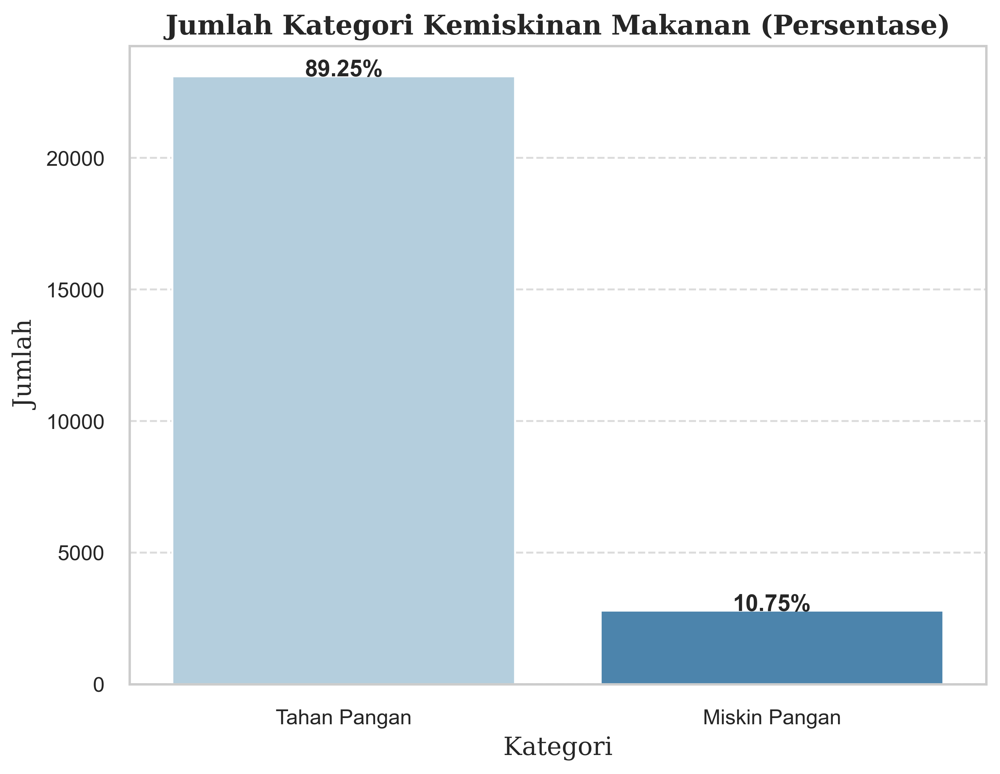

In [15]:
# Gabungan Jumlah - Persentase
count_df['Percentage'] = (count_df['Count'] / count_df['Count'].sum())*100

plt.figure(figsize=(8, 6))
sns.set_style('whitegrid')
sns.barplot(x='Kategori', y='Count', data=count_df, palette='Blues', saturation=0.7)

for i in range(len(count_df)):
    plt.text(
        i, count_df['Count'].iloc[i] + 1, 
        f"{count_df['Percentage'].iloc[i]:.2f}%", 
        ha='center', fontsize=12, fontweight='bold'
    )

plt.title('Jumlah Kategori Kemiskinan Makanan (Persentase)', fontsize=14, fontweight='bold', family='serif')
plt.xlabel('Kategori', fontsize=13, family='serif')
plt.ylabel('Jumlah', fontsize=13, family='serif')
plt.grid(True, axis='y', linestyle='--', alpha=0.7)
plt.show()

In [23]:
# Group By R102 - Food Label
prop_by_region = kp_raw.groupby('R102')['FOOD_LABEL'].value_counts(normalize=True).unstack()*100
prop_by_region.columns = ['Tahan Pangan', 'Miskin Pangan']
prop_by_region

,Tahan Pangan,Miskin Pangan
R102,,
1,88.176198,11.823802
2,87.847866,12.152134
3,82.938389,17.061611
4,91.423671,8.576329
5,85.562445,14.437555
6,73.346693,26.653307
7,92.189007,7.810993
8,87.484958,12.515042
9,89.498141,10.501859


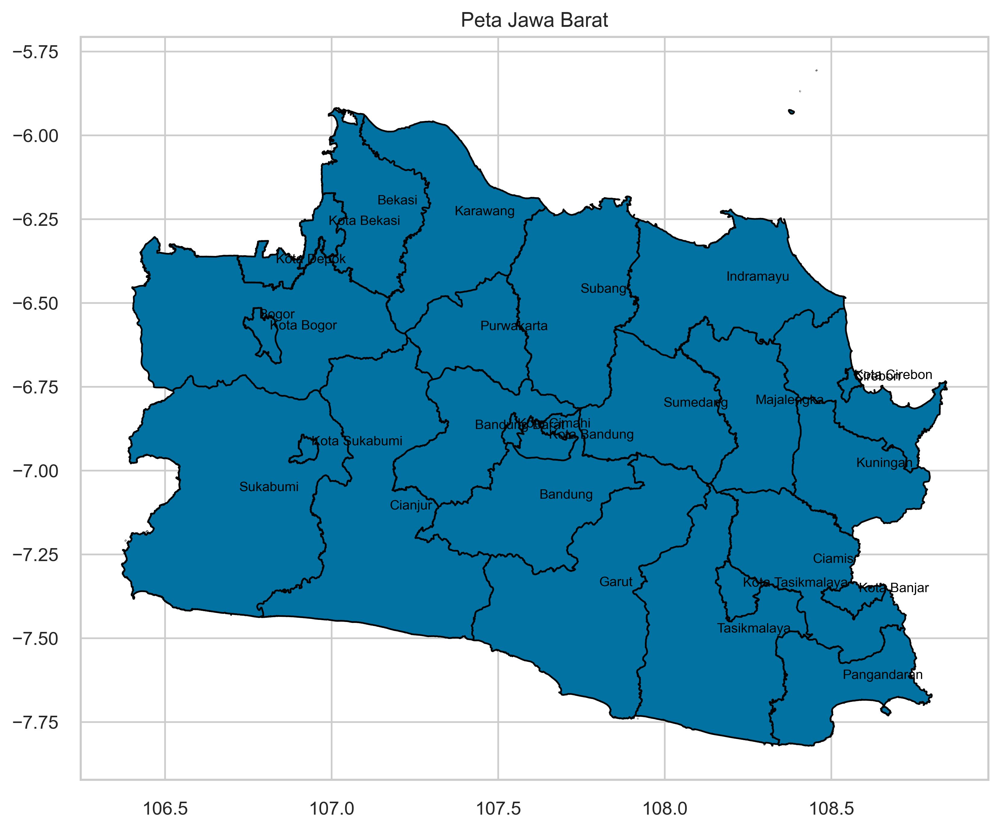

In [17]:
import geopandas as gpd
shapefile_path = r"D:\Kuliah IPB\02 Kuliah\03 Semester 3\Pemodelan Klasifikasi\P1\Tugas Kelompok\SHP\provjabar.shp"
gdf = gpd.read_file(shapefile_path)

fig, ax = plt.subplots(1, 1, figsize=(12, 8))
gdf.plot(ax=ax, edgecolor='black')
for idx, row in gdf.iterrows():
    plt.annotate(text=row['NAMOBJ'],
                 xy=row['geometry'].centroid.coords[0],
                 xytext=(3, 3),
                 textcoords='offset points',
                 fontsize=8,
                 color='black')

plt.title('Peta Jawa Barat')
plt.show()

In [21]:
# Data kode kabupaten
data_kabupaten = {
    'kode': ['32.01', '32.02', '32.03', '32.04', '32.05', '32.06', '32.07', '32.08', '32.09', '32.10', '32.11', '32.12', '32.13', '32.14', '32.15', '32.16', '32.17', '32.18', '32.71', '32.72', '32.73', '32.74', '32.75', '32.76', '32.77', '32.78', '32.79'],
    'kab/prov': ['Bogor', 'Sukabumi', 'Cianjur', 'Bandung', 'Garut', 'Tasikmalaya', 'Ciamis', 'Kuningan', 'Cirebon', 'Majalengka', 'Sumedang', 'Indramayu', 'Subang', 'Purwakarta', 'Karawang', 'Bekasi', 'Bandung Barat', 'Pangandaran', 'Kota Bogor', 'Kota Sukabumi', 'Kota Bandung', 'Kota Cirebon', 'Kota Bekasi', 'Kota Depok', 'Kota Cimahi', 'Kota Tasikmalaya', 'Kota Banjar']
}

df_kabupaten = pd.DataFrame(data_kabupaten)

df_kabupaten['kode'] = df_kabupaten['kode'].str.split('.').str[1].astype(int)
df_kabupaten.head()

,kode,kab/prov
0,1,Bogor
1,2,Sukabumi
2,3,Cianjur
3,4,Bandung
4,5,Garut


In [31]:
df_kabupaten['R102'] = df_kabupaten['kode']
merged_data = pd.merge(df_kabupaten, prop_by_region, left_on='R102', right_index=True, how='inner')
merged_data

,kode,kab/prov,R102,Tahan Pangan,Miskin Pangan
0,1,Bogor,1,88.176198,11.823802
1,2,Sukabumi,2,87.847866,12.152134
2,3,Cianjur,3,82.938389,17.061611
3,4,Bandung,4,91.423671,8.576329
4,5,Garut,5,85.562445,14.437555
5,6,Tasikmalaya,6,73.346693,26.653307
6,7,Ciamis,7,92.189007,7.810993
7,8,Kuningan,8,87.484958,12.515042
8,9,Cirebon,9,89.498141,10.501859
9,10,Majalengka,10,85.164835,14.835165


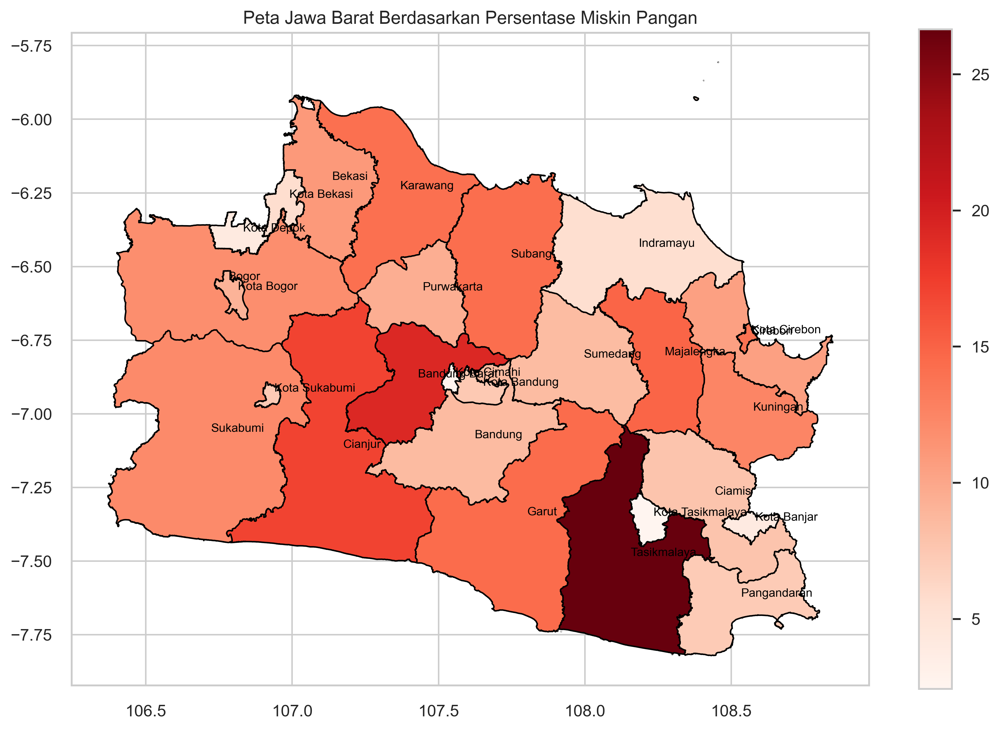

In [28]:
# Sebaran Kemiskinan Daerah
gdf['NAMOBJ'] = gdf['NAMOBJ'].str.title() 
merged_gdf = gdf.merge(merged_data, left_on='NAMOBJ', right_on='kab/prov', how='inner')
fig, ax = plt.subplots(1, 1, figsize=(12, 8))
merged_gdf.plot(column='Miskin Pangan', ax=ax, legend=True, cmap='Reds', edgecolor='black')

for idx, row in merged_gdf.iterrows():
    plt.annotate(text=row['NAMOBJ'],
                 xy=row['geometry'].centroid.coords[0],
                 xytext=(3, 3),
                 textcoords='offset points',
                 fontsize=8,
                 color='black')
plt.title('Peta Jawa Barat Berdasarkan Persentase Miskin Pangan')
plt.show()

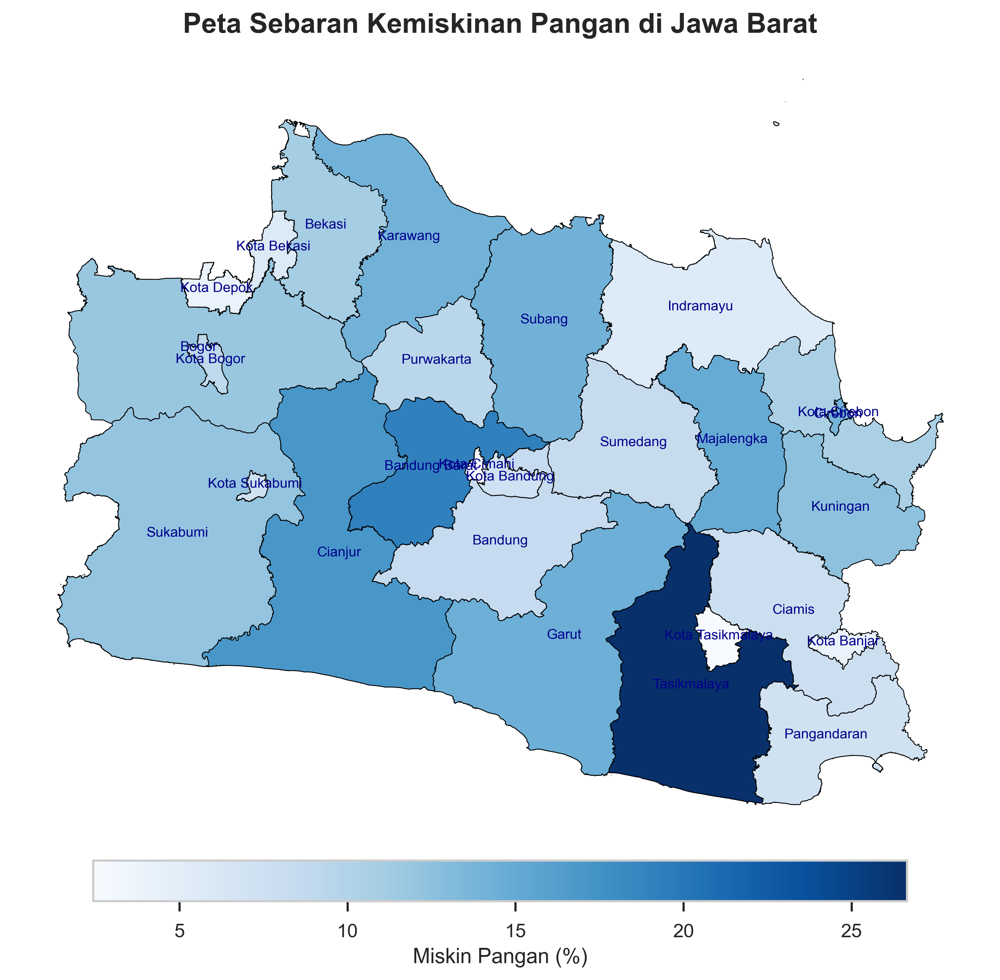

In [ ]:
# Peta tanpa gridlines
fig, ax = plt.subplots(1, 1, figsize=(14, 10))

merged_gdf.plot(
    column='Miskin Pangan',
    ax=ax,
    legend=True,
    cmap='Blues', 
    edgecolor='black',
    linewidth=0.5,
    legend_kwds={
        'label': "Miskin Pangan (%)",
        'orientation': "horizontal",
        'shrink': 0.6,
        'pad': 0.02
    }
)

for idx, row in merged_gdf.iterrows():
    plt.annotate(
        text=row['NAMOBJ'],
        xy=row['geometry'].centroid.coords[0],
        xytext=(0, 0),
        textcoords='offset points',
        fontsize=8,
        color='darkblue',
        ha='center'
    )
plt.title('Peta Sebaran Kemiskinan Pangan di Jawa Barat', fontsize=16, fontweight='bold')
ax.axis('off')
plt.show()

## Simulasi Kondisi 2

Karena kita fokus pada Y nya BINER maka abaikan simulasi kondisi 2

In [13]:
conditions = [
    kp_raw['FOOD_KAPITA'] < 367040,                   
    (kp_raw['FOOD_KAPITA'] >= 367040) & (kp_raw['FOOD_KAPITA'] <= 734080),
    kp_raw['FOOD_KAPITA'] > 734080                  
]
choices = [0, 1, 2]
kp_raw['FOOD_LABEL'] = np.select(conditions, choices)
kp_raw['FOOD_LABEL'] = kp_raw['FOOD_LABEL'].replace({0: 'Sangat Rentan', 1: 'Rentan', 2: 'Tidak Rentan'})
kp_raw.head()

,URUT,R101,R102,R105,R301,FOOD,NONFOOD,EXPEND,KAPITA,KALORI_KAP,...,LEMAK_KAP,KARBO_KAP,WERT,WEIND,PSU,SSU,WI1,WI2,FOOD_KAPITA,FOOD_LABEL
0,500001,32,7,2,4,2.660400e+06,2.304033e+06,4.964433e+06,1.241108e+06,2365.173362,...,43.222388,352.985743,454.889101,1819.556406,12448,123442,12435,123427,6.651000e+05,Rentan
1,500002,32,72,1,2,1.108714e+06,5.251667e+05,1.633881e+06,8.169405e+05,2611.639071,...,30.118243,471.997686,172.376821,344.753642,31373,311039,31360,311024,5.543571e+05,Rentan
2,500003,32,6,2,3,2.413886e+06,1.398333e+06,3.812219e+06,1.270740e+06,2526.510476,...,58.517619,360.456190,241.578661,724.735983,12092,119908,12079,119893,8.046286e+05,Tidak Rentan
3,500004,32,72,1,7,7.770000e+06,4.313333e+06,1.208333e+07,1.726190e+06,3655.854810,...,119.460426,454.939531,93.673563,655.714941,31135,308689,31122,308674,1.110000e+06,Tidak Rentan
4,500005,32,77,1,3,4.932557e+06,4.621975e+07,5.115231e+07,1.705077e+07,2330.987934,...,53.141607,254.846110,122.217556,366.652669,33988,336798,33975,336783,1.644186e+06,Tidak Rentan


In [14]:
# Hitung persen proporsi kelas 0,1 dan 2
prop_table = kp_raw['FOOD_LABEL'].value_counts(normalize=True)*100
prop_df = prop_table.reset_index()
prop_df.columns = ['Kategori', 'Percentage']
prop_df


,Kategori,Percentage
0,Tidak Rentan,44.770182
1,Rentan,44.476632
2,Sangat Rentan,10.753187


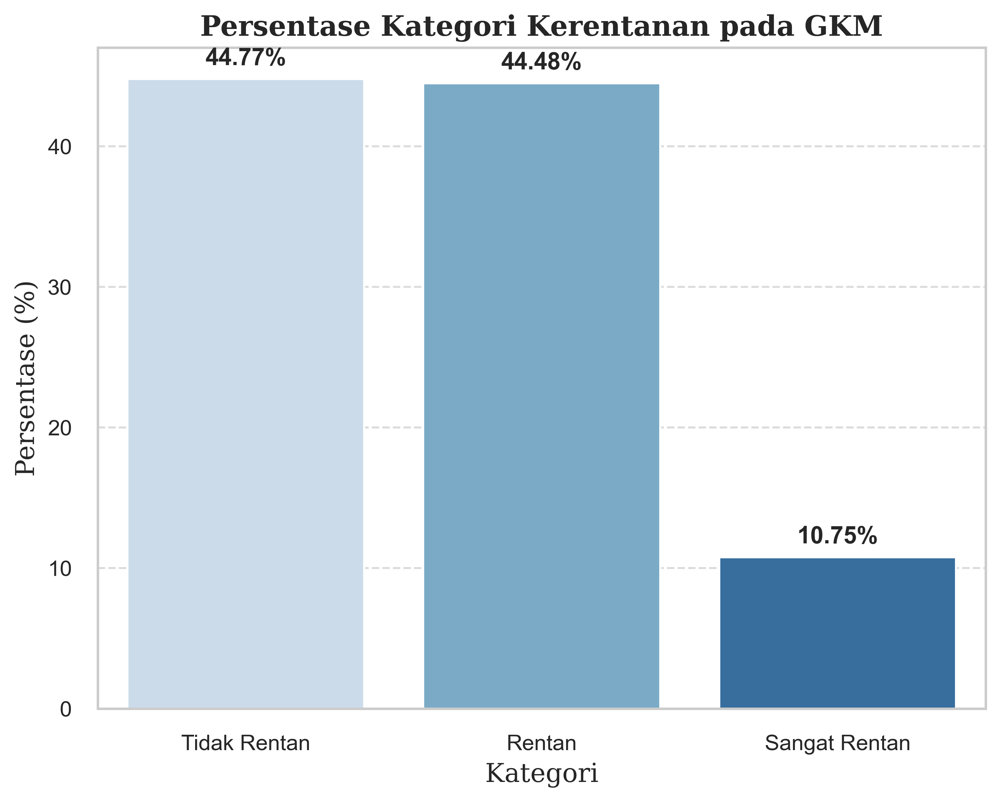

In [15]:
# Plotting proporsi kelas 0,1 dan 2
plt.figure(figsize=(8, 6))
sns.set_style('whitegrid')
sns.barplot(x='Kategori', y='Percentage', data=prop_df, palette='Blues', saturation=0.7)
for i in range(len(prop_df)):
    plt.text(i, prop_df['Percentage'].iloc[i] + 1, 
             f"{prop_df['Percentage'].iloc[i]:.2f}%", 
             ha='center', fontsize=12, fontweight='bold')
plt.title('Persentase Kategori Kerentanan pada GKM', 
          fontsize=14, fontweight='bold', family='serif')
plt.xlabel('Kategori', fontsize=13, family='serif')
plt.ylabel('Persentase (%)', fontsize=13, family='serif')
plt.grid(True, axis='y', linestyle='--', alpha=0.7)
plt.show()


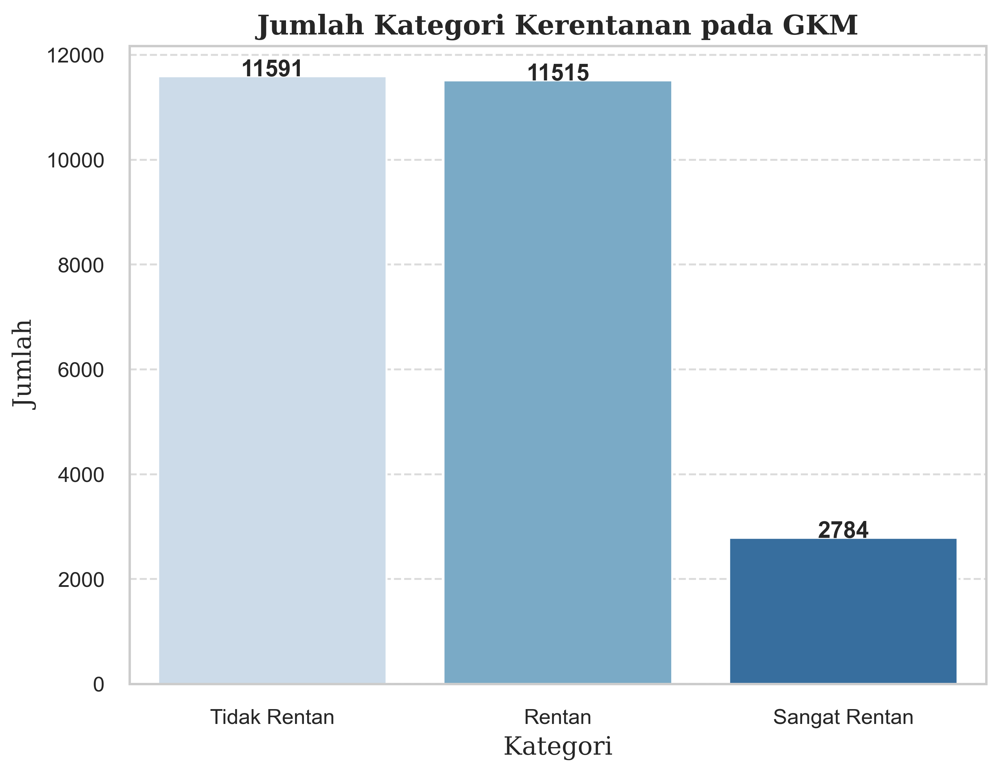

In [16]:
# Menghitung jumlah proporsi untuk 3 kelas
count_table = kp_raw['FOOD_LABEL'].replace({
    0: 'Rentan Pangan', 
    1: 'Tahan Pangan',
    2: 'Sedang'}).value_counts()
count_df = count_table.reset_index()
count_df.columns = ['Kategori', 'Count']

# Plotting barplot untuk 3 kelas
plt.figure(figsize=(8, 6))
sns.set_style('whitegrid')
sns.barplot(x='Kategori', y='Count', data=count_df, palette='Blues', saturation=0.7)
for i in range(len(count_df)):
    plt.text(i, count_df['Count'].iloc[i] + 1, f"{count_df['Count'].iloc[i]}", 
             ha='center', fontsize=12, fontweight='bold')
plt.title('Jumlah Kategori Kerentanan pada GKM', 
          fontsize=14, fontweight='bold', family='serif')
plt.xlabel('Kategori', fontsize=13, family='serif')
plt.ylabel('Jumlah', fontsize=13, family='serif')
plt.grid(True, axis='y', linestyle='--', alpha=0.7)
plt.show()

In [17]:
# Group By R102 - Food Label dengan 3 kelas
prop_by_region = kp_raw.groupby('R102')['FOOD_LABEL'].value_counts(normalize=True).unstack() * 100
prop_by_region.columns = ['Sangat Rentan ', 'Rentan', 'Tidak Rentan']
prop_by_region

,Sangat Rentan,Rentan,Tidak Rentan
R102,,,
1,51.313756,11.823802,36.862442
2,46.011132,12.152134,41.836735
3,52.701422,17.061611,30.236967
4,52.915952,8.576329,38.507719
5,51.992914,14.437555,33.569531
6,46.893788,26.653307,26.452906
7,58.630665,7.810993,33.558341
8,56.197353,12.515042,31.287605
9,50.185874,10.501859,39.312268


Hasil eksplorasi dari 2 simulasi didapatkan bahwa simulasi 2 secara subjektif dapat membagi tingkat kerentanan GKM di Prov. Jawa Barat akan diklasifikasikan menjadi 3 kelas (Sangat Rentan, Rentan, Tidak Rentan). Masalah berikutnya yang terjadi adalah pada dataset ini akan mengalami data yang tidak seimbang pada kelasnya sehingga membutuhkan penanganan khusus.

## Fitur Jenis_Pengeluaran

In [22]:
# Data COICCOP
file_path_c = r"C:\Users\LENOVO\Documents\Kuliah IPB\02 Kuliah\03 Semester 3\Pemodelan Klasifikasi\UAS\COICCOP.xlsx"
coicop = pd.read_excel(file_path_c)
coicop

,COICOP,Jenis_Konsumsi_Pengeluaran
0,01111001,A
1,01111003,A
2,01111006,A
3,01111005/2,A
4,01115005,A
...,...,...
174,02110000,M
175,02201001,N
176,02201002,N
177,02201003,N


In [23]:
# Data KP 4.1 (INDIVIDU)
file_path_kp41 = r"C:\Users\LENOVO\Documents\Kuliah IPB\02 Kuliah\03 Semester 3\Pemodelan Klasifikasi\P1\2023-20240820T092137Z-001\2023\csv\Modul KP (Konsumsi Pengeluaran)\2023 Maret JABAR - SUSENAS KP BP 4.1.csv"
kp41_raw = pd.read_csv(file_path_kp41, index_col=0)
kp41_raw

,URUT,R101,R102,R105,R301,KODE,KLP,COICOP,B41K5,B41K6,...,KALORI,PROTEIN,LEMAK,KARBO,WERT,WEIND,PSU,SSU,WI1,WI2
0,500001,32,7,2,4,1,0,NaN,0.0,92900,...,27019.0,638.25,106.50,5814.50,454.889101,1819.556406,12448,123442,12435,123427
1,500001,32,7,2,4,2,1,01111001,7.0,82900,...,25354.0,593.25,101.50,5428.50,454.889101,1819.556406,12448,123442,12435,123427
2,500001,32,7,2,4,6,1,01115005,0.5,10000,...,1665.0,45.00,5.00,386.00,454.889101,1819.556406,12448,123442,12435,123427
3,500001,32,7,2,4,8,0,NaN,0.0,0,...,6314.4,52.78,14.69,1489.39,454.889101,1819.556406,12448,123442,12435,123427
4,500001,32,7,2,4,9,8,01178001,0.0,0,...,3927.0,25.50,7.65,938.40,454.889101,1819.556406,12448,123442,12435,123427
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1410328,525890,32,71,1,2,159,0,NaN,0.0,72000,...,10066.8,241.95,183.38,1847.76,327.791104,655.582207,28056,278494,28043,278479
1410329,525890,32,71,1,2,160,159,01112005,20.0,28000,...,4970.0,159.00,27.00,997.00,327.791104,655.582207,28056,278494,28043,278479
1410330,525890,32,71,1,2,162,159,11111025/044,11.0,14000,...,4689.3,68.09,143.22,794.64,327.791104,655.582207,28056,278494,28043,278479
1410331,525890,32,71,1,2,181,159,11113008,2.0,24000,...,407.5,14.86,13.16,56.12,327.791104,655.582207,28056,278494,28043,278479


In [24]:
df = pd.merge(kp41_raw, coicop, on='COICOP', how='left')
df

,URUT,R101,R102,R105,R301,KODE,KLP,COICOP,B41K5,B41K6,...,PROTEIN,LEMAK,KARBO,WERT,WEIND,PSU,SSU,WI1,WI2,Jenis_Konsumsi_Pengeluaran
0,500001,32,7,2,4,1,0,NaN,0.0,92900,...,638.25,106.50,5814.50,454.889101,1819.556406,12448,123442,12435,123427,NaN
1,500001,32,7,2,4,2,1,01111001,7.0,82900,...,593.25,101.50,5428.50,454.889101,1819.556406,12448,123442,12435,123427,A
2,500001,32,7,2,4,6,1,01115005,0.5,10000,...,45.00,5.00,386.00,454.889101,1819.556406,12448,123442,12435,123427,A
3,500001,32,7,2,4,8,0,NaN,0.0,0,...,52.78,14.69,1489.39,454.889101,1819.556406,12448,123442,12435,123427,NaN
4,500001,32,7,2,4,9,8,01178001,0.0,0,...,25.50,7.65,938.40,454.889101,1819.556406,12448,123442,12435,123427,B
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1424743,525890,32,71,1,2,159,0,NaN,0.0,72000,...,241.95,183.38,1847.76,327.791104,655.582207,28056,278494,28043,278479,NaN
1424744,525890,32,71,1,2,160,159,01112005,20.0,28000,...,159.00,27.00,997.00,327.791104,655.582207,28056,278494,28043,278479,M
1424745,525890,32,71,1,2,162,159,11111025/044,11.0,14000,...,68.09,143.22,794.64,327.791104,655.582207,28056,278494,28043,278479,M
1424746,525890,32,71,1,2,181,159,11113008,2.0,24000,...,14.86,13.16,56.12,327.791104,655.582207,28056,278494,28043,278479,M


In [25]:
# Menggabungkan kolom COICOP berdasarkan URUT
df_grouped = df.groupby('URUT')['COICOP'].apply(lambda x: ', '.join(x.dropna().astype(str))).reset_index()
df_grouped

,URUT,COICOP
0,500001,"01111001, 01115005, 01178001, 01178001, 011780..."
1,500002,"01111001, 01115005, 01178002, 01131041, 011330..."
2,500003,"01111001, 01131046, 01133021/26/37, 01133036, ..."
3,500004,"01111001, 01115005, 01178002, 01131046, 011330..."
4,500005,"01111001, 01131041, 01124003, 01147002, 011430..."
...,...,...
25885,525886,"01111001, 01115005, 01178001, 01178001, 011780..."
25886,525887,"01111001, 01111006, 01115005, 01177000, 011310..."
25887,525888,"01111001, 01115005, 01177000, 01124003, 011470..."
25888,525889,"01111001, 01124003, 01125, 01147002, 01143003,..."


In [26]:
df_gabung = pd.merge(df_grouped, kp_raw, on='URUT', how='left')
df_gabung

,URUT,COICOP,R101,R102,R105,R301,FOOD,NONFOOD,EXPEND,KAPITA,...,LEMAK_KAP,KARBO_KAP,WERT,WEIND,PSU,SSU,WI1,WI2,FOOD_KAPITA,FOOD_LABEL
0,500001,"01111001, 01115005, 01178001, 01178001, 011780...",32,7,2,4,2.660400e+06,2.304033e+06,4.964433e+06,1.241108e+06,...,43.222388,352.985743,454.889101,1819.556406,12448,123442,12435,123427,6.651000e+05,1
1,500002,"01111001, 01115005, 01178002, 01131041, 011330...",32,72,1,2,1.108714e+06,5.251667e+05,1.633881e+06,8.169405e+05,...,30.118243,471.997686,172.376821,344.753642,31373,311039,31360,311024,5.543571e+05,1
2,500003,"01111001, 01131046, 01133021/26/37, 01133036, ...",32,6,2,3,2.413886e+06,1.398333e+06,3.812219e+06,1.270740e+06,...,58.517619,360.456190,241.578661,724.735983,12092,119908,12079,119893,8.046286e+05,1
3,500004,"01111001, 01115005, 01178002, 01131046, 011330...",32,72,1,7,7.770000e+06,4.313333e+06,1.208333e+07,1.726190e+06,...,119.460426,454.939531,93.673563,655.714941,31135,308689,31122,308674,1.110000e+06,1
4,500005,"01111001, 01131041, 01124003, 01147002, 011430...",32,77,1,3,4.932557e+06,4.621975e+07,5.115231e+07,1.705077e+07,...,53.141607,254.846110,122.217556,366.652669,33988,336798,33975,336783,1.644186e+06,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
25885,525886,"01111001, 01115005, 01178001, 01178001, 011780...",32,75,1,4,7.554857e+06,8.603709e+06,1.615857e+07,4.039642e+06,...,45.307661,306.247218,1229.081801,4916.327203,33078,327818,33065,327803,1.888714e+06,1
25886,525887,"01111001, 01111006, 01115005, 01177000, 011310...",32,16,1,5,3.572143e+06,5.581333e+06,9.153476e+06,1.830695e+06,...,46.467657,212.155300,531.663859,2658.319297,22856,226787,22843,226772,7.144286e+05,1
25887,525888,"01111001, 01115005, 01177000, 01124003, 011470...",32,16,1,5,2.878371e+06,2.718500e+06,5.596871e+06,1.119374e+06,...,45.535567,215.970774,1479.965203,7399.826013,23150,229731,23137,229716,5.756743e+05,1
25888,525889,"01111001, 01124003, 01125, 01147002, 01143003,...",32,73,1,4,1.719857e+06,3.712000e+06,5.431857e+06,1.357964e+06,...,41.464533,209.007286,1645.203314,6580.813255,31453,311836,31440,311821,4.299643e+05,1


In [27]:
# Unique COICOP
unique_jenis_konsumsi = coicop['Jenis_Konsumsi_Pengeluaran'].unique()
unique_jenis_konsumsi

array(['A', 'B', 'C', 'D', 'E', 'F', 'G', 'H', 'I', 'J', 'K', 'L', 'M',
       'N'], dtype=object)

In [28]:
# COICOP ke Unique value pengeluaran
for jenis in unique_jenis_konsumsi:
    df_gabung[f'Pengeluaran_Jenis_{jenis}'] = df_gabung['COICOP'].apply(
        lambda x: 1 if any(coicop_item.strip() in coicop[coicop['Jenis_Konsumsi_Pengeluaran'] == jenis]['COICOP'].values for coicop_item in x.split(', ')) else 0
    )
df_gabung.head()

,URUT,COICOP,R101,R102,R105,R301,FOOD,NONFOOD,EXPEND,KAPITA,...,Pengeluaran_Jenis_E,Pengeluaran_Jenis_F,Pengeluaran_Jenis_G,Pengeluaran_Jenis_H,Pengeluaran_Jenis_I,Pengeluaran_Jenis_J,Pengeluaran_Jenis_K,Pengeluaran_Jenis_L,Pengeluaran_Jenis_M,Pengeluaran_Jenis_N
0,500001,"01111001, 01115005, 01178001, 01178001, 011780...",32,7,2,4,2.660400e+06,2.304033e+06,4.964433e+06,1.241108e+06,...,1,1,1,1,1,1,1,1,1,0
1,500002,"01111001, 01115005, 01178002, 01131041, 011330...",32,72,1,2,1.108714e+06,5.251667e+05,1.633881e+06,8.169405e+05,...,1,1,1,1,1,1,1,1,1,1
2,500003,"01111001, 01131046, 01133021/26/37, 01133036, ...",32,6,2,3,2.413886e+06,1.398333e+06,3.812219e+06,1.270740e+06,...,1,1,1,1,1,1,1,1,1,1
3,500004,"01111001, 01115005, 01178002, 01131046, 011330...",32,72,1,7,7.770000e+06,4.313333e+06,1.208333e+07,1.726190e+06,...,1,1,1,1,1,1,1,1,1,1
4,500005,"01111001, 01131041, 01124003, 01147002, 011430...",32,77,1,3,4.932557e+06,4.621975e+07,5.115231e+07,1.705077e+07,...,1,1,1,1,1,1,1,1,1,1


In [46]:
#df_gabung.to_csv('df_gabung_output.csv', index=False)

In [29]:
df_gabung.columns

Index(['URUT', 'COICOP', 'R101', 'R102', 'R105', 'R301', 'FOOD', 'NONFOOD',
       'EXPEND', 'KAPITA', 'KALORI_KAP', 'PROTE_KAP', 'LEMAK_KAP', 'KARBO_KAP',
       'WERT', 'WEIND', 'PSU', 'SSU', 'WI1', 'WI2', 'FOOD_KAPITA',
       'FOOD_LABEL', 'Pengeluaran_Jenis_A', 'Pengeluaran_Jenis_B',
       'Pengeluaran_Jenis_C', 'Pengeluaran_Jenis_D', 'Pengeluaran_Jenis_E',
       'Pengeluaran_Jenis_F', 'Pengeluaran_Jenis_G', 'Pengeluaran_Jenis_H',
       'Pengeluaran_Jenis_I', 'Pengeluaran_Jenis_J', 'Pengeluaran_Jenis_K',
       'Pengeluaran_Jenis_L', 'Pengeluaran_Jenis_M', 'Pengeluaran_Jenis_N'],
      dtype='object')

In [30]:
hapus = ['COICOP', 'R101', 'R102', 'R105', 'R301', 'FOOD', 'NONFOOD', 'EXPEND', 'KAPITA', 'KALORI_KAP', 'PROTE_KAP', 'LEMAK_KAP', 'KARBO_KAP', 'WERT', 'WEIND', 'PSU', 'SSU', 'WI1', 'WI2', 'FOOD_KAPITA']
df_gabung = df_gabung.drop(columns=hapus, axis=1)
df_gabung.head()


,URUT,FOOD_LABEL,Pengeluaran_Jenis_A,Pengeluaran_Jenis_B,Pengeluaran_Jenis_C,Pengeluaran_Jenis_D,Pengeluaran_Jenis_E,Pengeluaran_Jenis_F,Pengeluaran_Jenis_G,Pengeluaran_Jenis_H,Pengeluaran_Jenis_I,Pengeluaran_Jenis_J,Pengeluaran_Jenis_K,Pengeluaran_Jenis_L,Pengeluaran_Jenis_M,Pengeluaran_Jenis_N
0,500001,1,1,1,1,1,1,1,1,1,1,1,1,1,1,0
1,500002,1,1,1,1,0,1,1,1,1,1,1,1,1,1,1
2,500003,1,1,0,1,1,1,1,1,1,1,1,1,1,1,1
3,500004,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1
4,500005,1,1,0,1,1,1,1,1,1,1,1,1,1,1,1


In [31]:
df_gabung.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 25890 entries, 0 to 25889
Data columns (total 16 columns):
 #   Column               Non-Null Count  Dtype
---  ------               --------------  -----
 0   URUT                 25890 non-null  int64
 1   FOOD_LABEL           25890 non-null  int32
 2   Pengeluaran_Jenis_A  25890 non-null  int64
 3   Pengeluaran_Jenis_B  25890 non-null  int64
 4   Pengeluaran_Jenis_C  25890 non-null  int64
 5   Pengeluaran_Jenis_D  25890 non-null  int64
 6   Pengeluaran_Jenis_E  25890 non-null  int64
 7   Pengeluaran_Jenis_F  25890 non-null  int64
 8   Pengeluaran_Jenis_G  25890 non-null  int64
 9   Pengeluaran_Jenis_H  25890 non-null  int64
 10  Pengeluaran_Jenis_I  25890 non-null  int64
 11  Pengeluaran_Jenis_J  25890 non-null  int64
 12  Pengeluaran_Jenis_K  25890 non-null  int64
 13  Pengeluaran_Jenis_L  25890 non-null  int64
 14  Pengeluaran_Jenis_M  25890 non-null  int64
 15  Pengeluaran_Jenis_N  25890 non-null  int64
dtypes: int32(1), int64(15)

## Fitur KOR-RT

In [32]:
# Data KOR-RT
file_path_kor = r"C:\Users\LENOVO\Documents\Kuliah IPB\02 Kuliah\03 Semester 3\Pemodelan Klasifikasi\P1\2023-20240820T092137Z-001\2023\csv\KOR\2023 Maret JABAR - SUSENAS KOR Rumah Tangga.csv"
kor_raw = pd.read_csv(file_path_kor, index_col=0)
kor_raw

,URUT,PSU,SSU,WI1,WI2,R101,R102,R105,NUINFORT,R1701,...,R2211A4,R2211A5,R2211B,R2211B1,R301,R302,R303,R304,R305,FWT
0,500001,12448,123442,12435,123427,32,7,2,2,5,...,0,0,5,0,4,0,4,3,1,454.889101
1,500002,31373,311039,31360,311024,32,72,1,1,1,...,0,0,5,0,2,0,2,2,0,172.376821
2,500003,12092,119908,12079,119893,32,6,2,2,5,...,0,0,5,0,3,0,3,3,1,241.578661
3,500004,31135,308689,31122,308674,32,72,1,2,5,...,0,0,5,0,7,1,6,5,1,93.673563
4,500005,33988,336798,33975,336783,32,77,1,1,5,...,0,0,5,0,3,0,3,3,1,122.217556
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
25885,525886,33078,327818,33065,327803,32,75,1,2,5,...,0,0,5,0,4,0,4,4,0,1229.081801
25886,525887,22856,226787,22843,226772,32,16,1,2,5,...,0,0,5,0,5,0,5,3,1,531.663859
25887,525888,23150,229731,23137,229716,32,16,1,2,1,...,0,0,5,0,5,1,4,2,1,1479.965203
25888,525889,31453,311836,31440,311821,32,73,1,2,5,...,0,0,5,0,4,0,4,4,1,1645.203314


Karena menggunakan data pangan maka kita akan mencari fitur yang sekiranya mempunyai hubungan dengan pangan seperti: 1) Apakah menerima bantuan pangan; 2) Berapa nilai bantuan yang diterima; 3) Berapa yang dibelanjakan untuk membeli beras (rupiah); 4) Berapa yang dibelanjakan untuk membeli telur (rupiah) dan; 5) Berapa yang dIbelanjakan untuk membeli komoditas lainnya (rupiah). 

Sebagai catatan, ke-5 peubah ini ternyata memiliki rentang waktu dari Nov 2022 - Des 2023. Sehingga kita dapat membuat agregasi peubah untuk bulan yang sama pada peubah numerik. sebagai contoh pada peubah: 2) Berapa nilai bantuan yang diterima; 3) Berapa yang dibelanjakan untuk membeli beras (rupiah); 4) Berapa yang dibelanjakan untuk membeli telur (rupiah) dan; 5) Berapa yang dIbelanjakan untuk membeli komoditas lainnya (rupiah). 

In [33]:
kor_pilih = [
    'URUT', 'R2208A2', 'R2208A3', 'R2208A4', 'R2208A5', 
    'R2208BI2', 'R2208BI3', 'R2208BI4', 'R2208BI5', 
    'R2208EIB2', 'R2208EIB3', 'R2208EIB4', 'R2208EIB5', 
    'R2208EIT2', 'R2208EIT3', 'R2208EIT4', 'R2208EIT5', 
    'R2208EIL2', 'R2208EIL3', 'R2208EIL4', 'R2208EIL5']
df_kor = kor_raw[kor_pilih]
df_kor

,URUT,R2208A2,R2208A3,R2208A4,R2208A5,R2208BI2,R2208BI3,R2208BI4,R2208BI5,R2208EIB2,...,R2208EIB4,R2208EIB5,R2208EIT2,R2208EIT3,R2208EIT4,R2208EIT5,R2208EIL2,R2208EIL3,R2208EIL4,R2208EIL5
0,500001,5,5,1,5,0,0,600000,0,0,...,200000,0,0,0,40000,0,0,0,70000,0
1,500002,5,5,5,1,0,0,0,600000,0,...,0,110000,0,0,0,26000,0,0,0,32000
2,500003,5,5,1,5,0,0,400000,0,0,...,240000,0,0,0,60000,0,0,0,100000,0
3,500004,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
4,500005,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
25885,525886,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
25886,525887,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
25887,525888,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
25888,525889,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0


- Kita akan memberi LABEL_ENCODING pada 'R2208A2', 'R2208A3', 'R2208A4', 'R2208A5' dimana 1 = 'Ya' dan 5 = 'Tidak' \
- Kita akan melakukan agregasi rata-rata untuk peubah lainnya

In [34]:
label_encode = ['R2208A2', 'R2208A3', 'R2208A4', 'R2208A5']

# Label encoding: 1 = 'Ya', 5 = 'Tidak', 0 = 'Tidak'
encoding_map = {1: 'Ya', 5: 'Tidak', 0: 'Tidak'}
for col in label_encode:
    df_kor[col] = df_kor[col].map(encoding_map)

# Agregasi Rataan Nov 22 - Feb 23
df_kor['nilai_bantuan(rp)'] = df_kor[['R2208BI2', 'R2208BI3', 'R2208BI4', 'R2208BI5']].mean(axis=1)
df_kor['rataan_beras(rp)'] = df_kor[['R2208EIB2', 'R2208EIB3', 'R2208EIB4', 'R2208EIB5']].mean(axis=1)
df_kor['rataan_telur(rp)'] = df_kor[['R2208EIT2', 'R2208EIT3', 'R2208EIT4', 'R2208EIT5']].mean(axis=1)
df_kor['rataan_lainnya(rp)'] = df_kor[['R2208EIL2', 'R2208EIL3', 'R2208EIL4', 'R2208EIL5']].mean(axis=1)

# Drop peubah raw
hapus_kor = [
    'R2208BI2', 'R2208BI3', 'R2208BI4', 'R2208BI5', 
    'R2208EIB2', 'R2208EIB3', 'R2208EIB4', 'R2208EIB5', 
    'R2208EIT2', 'R2208EIT3', 'R2208EIT4', 'R2208EIT5', 
    'R2208EIL2', 'R2208EIL3', 'R2208EIL4', 'R2208EIL5'
]
df_kor = df_kor.drop(columns=hapus_kor)
df_kor.head()

,URUT,R2208A2,R2208A3,R2208A4,R2208A5,nilai_bantuan(rp),rataan_beras(rp),rataan_telur(rp),rataan_lainnya(rp)
0,500001,Tidak,Tidak,Ya,Tidak,150000.0,50000.0,10000.0,17500.0
1,500002,Tidak,Tidak,Tidak,Ya,150000.0,27500.0,6500.0,8000.0
2,500003,Tidak,Tidak,Ya,Tidak,100000.0,60000.0,15000.0,25000.0
3,500004,Tidak,Tidak,Tidak,Tidak,0.0,0.0,0.0,0.0
4,500005,Tidak,Tidak,Tidak,Tidak,0.0,0.0,0.0,0.0


In [35]:
df_kor.info()

<class 'pandas.core.frame.DataFrame'>
Index: 25890 entries, 0 to 25889
Data columns (total 9 columns):
 #   Column              Non-Null Count  Dtype  
---  ------              --------------  -----  
 0   URUT                25890 non-null  int64  
 1   R2208A2             25890 non-null  object 
 2   R2208A3             25890 non-null  object 
 3   R2208A4             25890 non-null  object 
 4   R2208A5             25890 non-null  object 
 5   nilai_bantuan(rp)   25890 non-null  float64
 6   rataan_beras(rp)    25890 non-null  float64
 7   rataan_telur(rp)    25890 non-null  float64
 8   rataan_lainnya(rp)  25890 non-null  float64
dtypes: float64(4), int64(1), object(4)
memory usage: 2.0+ MB


## Data Pemodelan

In [36]:
df_model = pd.merge(df_gabung, df_kor, on='URUT', how='left')
df_model

,URUT,FOOD_LABEL,Pengeluaran_Jenis_A,Pengeluaran_Jenis_B,Pengeluaran_Jenis_C,Pengeluaran_Jenis_D,Pengeluaran_Jenis_E,Pengeluaran_Jenis_F,Pengeluaran_Jenis_G,Pengeluaran_Jenis_H,...,Pengeluaran_Jenis_M,Pengeluaran_Jenis_N,R2208A2,R2208A3,R2208A4,R2208A5,nilai_bantuan(rp),rataan_beras(rp),rataan_telur(rp),rataan_lainnya(rp)
0,500001,1,1,1,1,1,1,1,1,1,...,1,0,Tidak,Tidak,Ya,Tidak,150000.0,50000.0,10000.0,17500.0
1,500002,1,1,1,1,0,1,1,1,1,...,1,1,Tidak,Tidak,Tidak,Ya,150000.0,27500.0,6500.0,8000.0
2,500003,1,1,0,1,1,1,1,1,1,...,1,1,Tidak,Tidak,Ya,Tidak,100000.0,60000.0,15000.0,25000.0
3,500004,1,1,1,1,1,1,1,1,1,...,1,1,Tidak,Tidak,Tidak,Tidak,0.0,0.0,0.0,0.0
4,500005,1,1,0,1,1,1,1,1,1,...,1,1,Tidak,Tidak,Tidak,Tidak,0.0,0.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
25885,525886,1,1,1,1,1,1,1,1,1,...,1,1,Tidak,Tidak,Tidak,Tidak,0.0,0.0,0.0,0.0
25886,525887,1,1,0,1,1,1,1,1,1,...,1,0,Tidak,Tidak,Tidak,Tidak,0.0,0.0,0.0,0.0
25887,525888,1,1,0,0,1,1,1,1,1,...,1,1,Tidak,Tidak,Tidak,Tidak,0.0,0.0,0.0,0.0
25888,525889,1,1,0,0,1,1,1,1,1,...,1,0,Tidak,Tidak,Tidak,Tidak,0.0,0.0,0.0,0.0


In [37]:
#df_model.to_csv('df_model.csv', index=False)

# Ekplorasi Data

In [2]:
file_path = r"D:\Kuliah IPB\02 Kuliah\03 Semester 3\Pemodelan Klasifikasi\UAS\df_model.csv"
df_model = pd.read_csv(file_path, index_col=0)
df_model

,R105,KALORI_KAP,PROTE_KAP,LEMAK_KAP,KARBO_KAP,FOOD_LABEL,Pengeluaran_Jenis_A,Pengeluaran_Jenis_B,Pengeluaran_Jenis_C,Pengeluaran_Jenis_D,...,Pengeluaran_Jenis_M,Pengeluaran_Jenis_N,R2208A2,R2208A3,R2208A4,R2208A5,nilai_bantuan(rp),rataan_beras(rp),rataan_telur(rp),rataan_lainnya(rp)
URUT,,,,,,,,,,,,,,,,,,,,,
500001,2,2365.173362,67.130240,43.222388,352.985743,0,1,1,1,1,...,1,0,Tidak,Tidak,Ya,Tidak,150000.0,50000.0,10000.0,17500.0
500002,1,2611.639071,69.091893,30.118243,471.997686,0,1,1,1,0,...,1,1,Tidak,Tidak,Tidak,Ya,150000.0,27500.0,6500.0,8000.0
500003,2,2526.510476,68.742619,58.517619,360.456190,0,1,0,1,1,...,1,1,Tidak,Tidak,Ya,Tidak,100000.0,60000.0,15000.0,25000.0
500004,1,3655.854810,141.502615,119.460426,454.939531,0,1,1,1,1,...,1,1,Tidak,Tidak,Tidak,Tidak,0.0,0.0,0.0,0.0
500005,1,2330.987934,78.533354,53.141607,254.846110,0,1,0,1,1,...,1,1,Tidak,Tidak,Tidak,Tidak,0.0,0.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
525886,1,2227.460536,81.321857,45.307661,306.247218,0,1,1,1,1,...,1,1,Tidak,Tidak,Tidak,Tidak,0.0,0.0,0.0,0.0
525887,1,1711.114357,68.675743,46.467657,212.155300,0,1,0,1,1,...,1,0,Tidak,Tidak,Tidak,Tidak,0.0,0.0,0.0,0.0
525888,1,1621.781673,48.896660,45.535567,215.970774,0,1,0,0,1,...,1,1,Tidak,Tidak,Tidak,Tidak,0.0,0.0,0.0,0.0


In [ ]:
# label_encoder = LabelEncoder()
# df_model['FOOD_LABEL'] = label_encoder.fit_transform(df_model['FOOD_LABEL'].map({0: 'Tahan Pangan', 1: 'Miskin Pangan'}))
# df_model[['FOOD_LABEL']].head()

,FOOD_LABEL
URUT,
500001,1
500002,1
500003,1
500004,1
500005,1


In [3]:
df_model.info()

<class 'pandas.core.frame.DataFrame'>
Index: 25890 entries, 500001 to 525890
Data columns (total 28 columns):
 #   Column               Non-Null Count  Dtype  
---  ------               --------------  -----  
 0   R105                 25890 non-null  int64  
 1   KALORI_KAP           25890 non-null  float64
 2   PROTE_KAP            25890 non-null  float64
 3   LEMAK_KAP            25890 non-null  float64
 4   KARBO_KAP            25890 non-null  float64
 5   FOOD_LABEL           25890 non-null  int64  
 6   Pengeluaran_Jenis_A  25890 non-null  int64  
 7   Pengeluaran_Jenis_B  25890 non-null  int64  
 8   Pengeluaran_Jenis_C  25890 non-null  int64  
 9   Pengeluaran_Jenis_D  25890 non-null  int64  
 10  Pengeluaran_Jenis_E  25890 non-null  int64  
 11  Pengeluaran_Jenis_F  25890 non-null  int64  
 12  Pengeluaran_Jenis_G  25890 non-null  int64  
 13  Pengeluaran_Jenis_H  25890 non-null  int64  
 14  Pengeluaran_Jenis_I  25890 non-null  int64  
 15  Pengeluaran_Jenis_J  25890 non-null

## Fitur Kategorik

### Jenis Pengeluaran

In [4]:
fitur_pengeluaran = [
    'Pengeluaran_Jenis_A', 'Pengeluaran_Jenis_B', 'Pengeluaran_Jenis_C', 'Pengeluaran_Jenis_D', 
    'Pengeluaran_Jenis_E', 'Pengeluaran_Jenis_F', 'Pengeluaran_Jenis_G', 'Pengeluaran_Jenis_H', 
    'Pengeluaran_Jenis_I', 'Pengeluaran_Jenis_J', 'Pengeluaran_Jenis_K', 'Pengeluaran_Jenis_L', 
    'Pengeluaran_Jenis_M', 'Pengeluaran_Jenis_N'
]
proporsi_pengeluaran = pd.DataFrame()
for col in fitur_pengeluaran:
    proporsi_pengeluaran[col] = df_model[col].value_counts(normalize=True)
proporsi_pengeluaran.index = ['Ya', 'Tidak']
proporsi_pengeluaran.T

,Ya,Tidak
Pengeluaran_Jenis_A,0.986790,0.013210
Pengeluaran_Jenis_B,0.427964,0.572036
Pengeluaran_Jenis_C,0.876246,0.123754
Pengeluaran_Jenis_D,0.762997,0.237003
Pengeluaran_Jenis_E,0.955427,0.044573
Pengeluaran_Jenis_F,0.955002,0.044998
Pengeluaran_Jenis_G,0.923832,0.076168
Pengeluaran_Jenis_H,0.896215,0.103785
Pengeluaran_Jenis_I,0.971842,0.028158
Pengeluaran_Jenis_J,0.961645,0.038355


<Figure size 6400x4000 with 0 Axes>

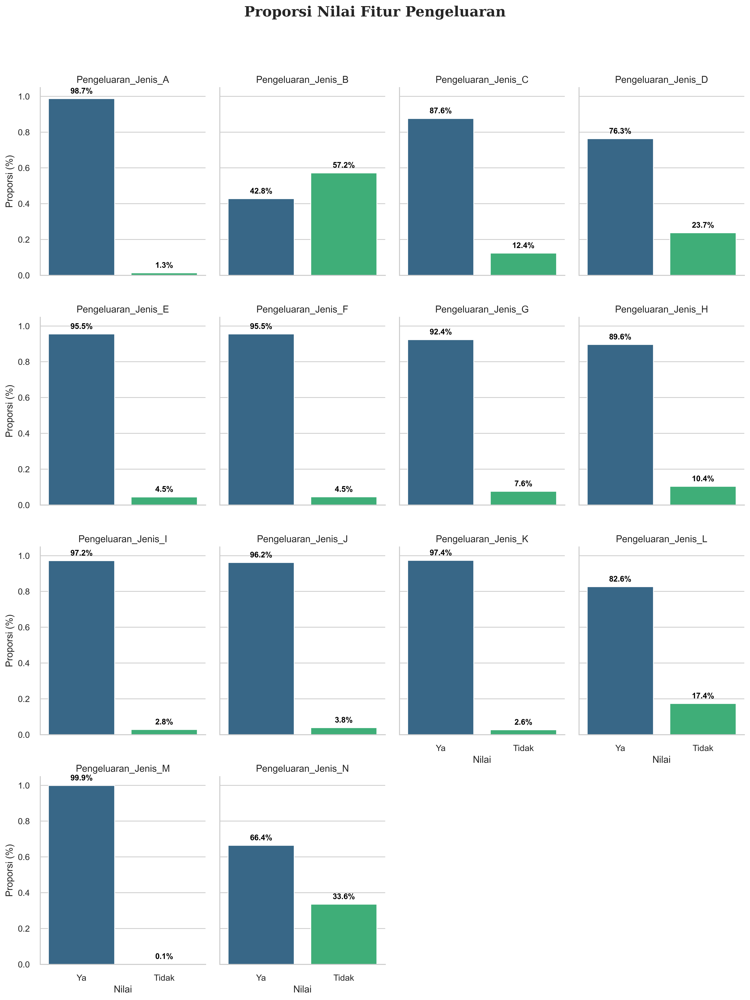

In [5]:
proporsi_melted = proporsi_pengeluaran.T.reset_index().melt(id_vars='index', var_name='Nilai', value_name='Proporsi')
proporsi_melted.columns = ['Fitur', 'Nilai', 'Proporsi']
plt.figure(figsize=(16, 10))
sns.set_style('whitegrid')
sns.set_palette('coolwarm')

g = sns.catplot(
    data=proporsi_melted, x='Nilai', y='Proporsi', hue='Nilai', col='Fitur',
    kind='bar', col_wrap=4, height=4.5, aspect=0.75, saturation=0.85, palette="viridis"
)

for ax in g.axes.flat:
    for bar in ax.patches:
        ax.text(
            bar.get_x() + bar.get_width() / 2, bar.get_height() + 0.02,
            f"{bar.get_height() * 100:.1f}%", ha='center', va='bottom',
            fontsize=10, fontweight='bold', color="black"
        )
        
g.set_titles("{col_name}")
g.set_axis_labels("Nilai", "Proporsi (%)")
g.fig.suptitle('Proporsi Nilai Fitur Pengeluaran', fontsize=18, fontweight='bold', family='serif')
g.fig.tight_layout(pad=1.5)
g.fig.subplots_adjust(top=0.9)
plt.show()

### Bantuan Pangan

In [14]:
fitur_bantuanpangan = ['R2208A2', 'R2208A3', 'R2208A4', 'R2208A5']
proporsi_fitur_bantuanpangan = pd.DataFrame()
for col in fitur_bantuanpangan:
    proporsi_fitur_bantuanpangan[col] = df_model[col].value_counts(normalize=True)
proporsi_fitur_bantuanpangan.index = ['Tidak', 'Ya']
proporsi_fitur_bantuanpangan.T

,Tidak,Ya
R2208A2,0.973542,0.026458
R2208A3,0.977520,0.022480
R2208A4,0.855272,0.144728
R2208A5,0.842796,0.157204


<Figure size 4800x3200 with 0 Axes>

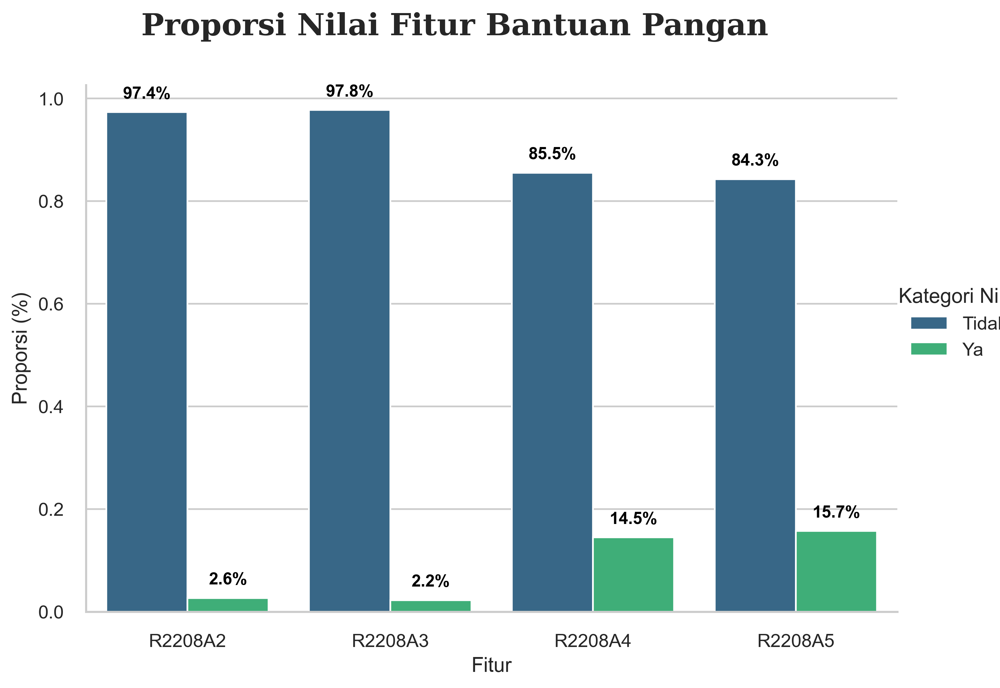

In [15]:
proporsi_melted = proporsi_fitur_bantuanpangan.T.reset_index().melt(id_vars='index', var_name='Nilai', value_name='Proporsi')
proporsi_melted.columns = ['Fitur', 'Nilai', 'Proporsi']
plt.figure(figsize=(12, 8))
sns.set_style('whitegrid')

g = sns.catplot(
    data=proporsi_melted, x='Fitur', y='Proporsi', hue='Nilai',
    kind='bar', height=6, aspect=1.2, saturation=0.85, palette="viridis"
)

for ax in g.axes.flat:
    for bar in ax.patches:
        if bar.get_height() > 0:
            ax.text(
                bar.get_x() + bar.get_width() / 2, bar.get_height() + 0.02,
                f"{bar.get_height() * 100:.1f}%", ha='center', va='bottom',
                fontsize=10, fontweight='bold', color="black"
            )
            
g.set_axis_labels("Fitur", "Proporsi (%)")
g.fig.suptitle('Proporsi Nilai Fitur Bantuan Pangan', fontsize=18, fontweight='bold', family='serif')
g._legend.set_bbox_to_anchor((1.05, 0.5))
g._legend.set_title("Kategori Nilai")
g.fig.tight_layout(pad=2.5)
g.fig.subplots_adjust(top=0.88)
plt.show()

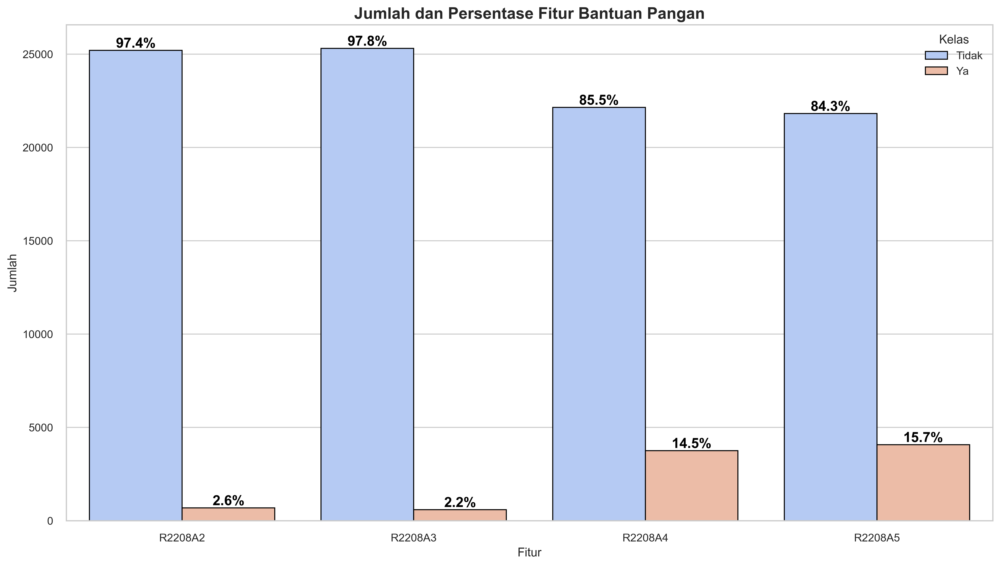

In [17]:
results = []
for col in fitur_bantuanpangan:
    counts = df_model[col].value_counts()
    total = counts.sum()
    percentages = (counts / total) * 100
    results.append({
        'Fitur': col,
        'Tidak Jumlah': counts.get(0, 0),
        'Ya Jumlah': counts.get(1, 0),
        'Tidak Persen': percentages.get(0, 0),
        'Ya Persen': percentages.get(1, 0)
    })

results_df = pd.DataFrame(results)
melted_results = results_df.melt(
    id_vars='Fitur',
    value_vars=['Tidak Jumlah', 'Ya Jumlah'],
    var_name='Kelas',
    value_name='Jumlah'
)

melted_results['Persentase'] = melted_results.apply(
    lambda row: results_df.loc[results_df['Fitur'] == row['Fitur'], 'Tidak Persen' if row['Kelas'] == 'Tidak Jumlah' else 'Ya Persen'].values[0],
    axis=1
)
melted_results['Kelas'] = melted_results['Kelas'].replace({
    'Tidak Jumlah': 'Tidak',
    'Ya Jumlah': 'Ya'
})
plt.figure(figsize=(14, 8))
sns.set_style('whitegrid')

g = sns.barplot(data=melted_results, x='Fitur', y='Jumlah', hue='Kelas', palette='coolwarm', edgecolor='black')
for bar, percentage in zip(g.patches, melted_results['Persentase']):
    g.annotate(
        f"{percentage:.1f}%", 
        (bar.get_x() + bar.get_width() / 2, bar.get_height()), 
        ha='center', va='bottom', fontsize=14, color='black', fontweight='bold'
    )
plt.title('Jumlah dan Persentase Fitur Bantuan Pangan', fontsize=16, weight='bold')
plt.xlabel('Fitur', fontsize=12)
plt.ylabel('Jumlah', fontsize=12)
plt.legend(title='Kelas', loc='upper right')
plt.tight_layout()
plt.show()

### Klasifikasi Wilayah

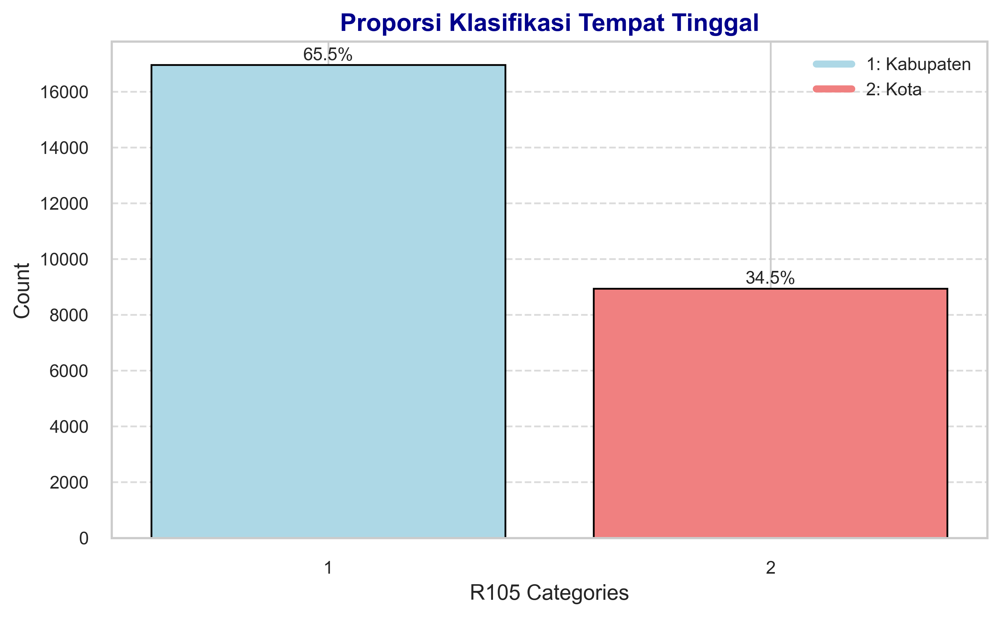

In [18]:
r105_counts = df_model['R105'].value_counts()
r105_percentages = (r105_counts / r105_counts.sum()) * 100

colors = ['lightblue', 'lightcoral']
plt.figure(figsize=(8, 5))
bars = plt.bar(r105_counts.index.astype(str), r105_counts.values, color=colors, edgecolor='black')
for i, bar in enumerate(bars):
    plt.text(bar.get_x() + bar.get_width() / 2, bar.get_height() + 50,
             f'{r105_percentages.iloc[i]:.1f}%', ha='center', va='bottom', fontsize=10)

plt.title('Proporsi Klasifikasi Tempat Tinggal', fontsize=14, weight='bold', color='darkblue')
plt.xlabel('R105 Categories', fontsize=12)
plt.ylabel('Count', fontsize=12)
plt.xticks(fontsize=10)
plt.yticks(fontsize=10)
plt.grid(axis='y', linestyle='--', alpha=0.7)
plt.legend(handles=[
    plt.Line2D([0], [0], color='lightblue', lw=4, label='1: Kabupaten'),
    plt.Line2D([0], [0], color='lightcoral', lw=4, label='2: Kota')
], loc='upper right', fontsize=10)
plt.tight_layout()
plt.show()

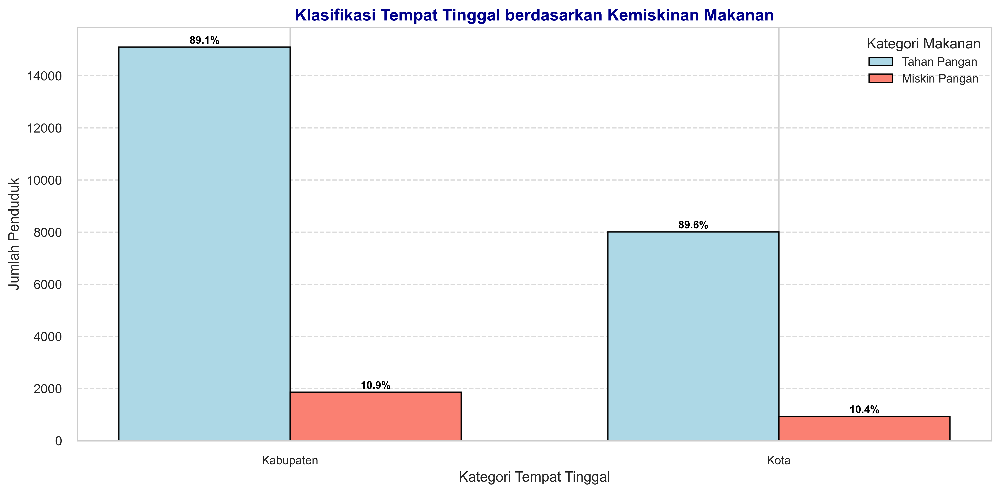

In [19]:
r105_food_counts = df_model.groupby(['R105', 'FOOD_LABEL']).size().unstack(fill_value=0)
x_labels = ['Kabupaten' if x == 1 else 'Kota' for x in r105_food_counts.index]
plt.figure(figsize=(12, 6))
bar_width = 0.35
x = range(len(r105_food_counts.index))
colors = ['lightblue', 'salmon']

for i, (label, color) in enumerate(zip(r105_food_counts.columns, colors)):
    plt.bar(
        [pos + i * bar_width for pos in x],
        r105_food_counts[label],
        bar_width,
        label=f"{'Tahan Pangan' if label == 0 else 'Miskin Pangan'}",
        color=color,
        edgecolor='black'
    )

for i, r105_category in enumerate(r105_food_counts.index):
    for j, label in enumerate(r105_food_counts.columns):
        count = r105_food_counts.loc[r105_category, label]
        total = r105_food_counts.loc[r105_category].sum()
        percentage = (count / total) * 100 if total > 0 else 0
        if count > 0:
            plt.text(
                i + j * bar_width, count + 50, 
                f"{percentage:.1f}%", 
                ha='center', va='bottom', fontsize=9, fontweight='bold', color='black'
            )

plt.xticks([pos + bar_width / 2 for pos in x], x_labels, fontsize=10)
plt.xlabel('Kategori Tempat Tinggal', fontsize=12)
plt.ylabel('Jumlah Penduduk', fontsize=12)
plt.title('Klasifikasi Tempat Tinggal berdasarkan Kemiskinan Makanan', fontsize=14, weight='bold', color='darkblue')
plt.legend(title='Kategori Makanan', fontsize=10, loc='upper right')
plt.grid(axis='y', linestyle='--', alpha=0.7)
plt.tight_layout()
plt.show()

In [20]:
r105_food_counts

FOOD_LABEL,0,1
R105,,
1,15097,1856
2,8009,928


### Plot Fitur Kategorik

In [21]:
fitur_kategorik = [
    'FOOD_LABEL', 'Pengeluaran_Jenis_A', 'Pengeluaran_Jenis_B', 'Pengeluaran_Jenis_C',
    'Pengeluaran_Jenis_D', 'Pengeluaran_Jenis_E', 'Pengeluaran_Jenis_F', 'Pengeluaran_Jenis_G',
    'Pengeluaran_Jenis_H', 'Pengeluaran_Jenis_I', 'Pengeluaran_Jenis_J', 'Pengeluaran_Jenis_K',
    'Pengeluaran_Jenis_L', 'Pengeluaran_Jenis_M', 'Pengeluaran_Jenis_N',
    'R2208A2', 'R2208A3', 'R2208A4', 'R2208A5','R105'
]

fig, axes = plt.subplots(nrows=10, ncols=2, figsize=(20, 30)) 
axes = axes.flatten()
for i, feature in enumerate(fitur_kategorik):
    ax = axes[i]
    sns.countplot(data=df_model, y=feature, ax=ax, palette="viridis")
    ax.set_title(f'Distribusi {feature}', fontsize=12, fontweight='bold')
    ax.grid(True, linestyle='--', alpha=0.7)
    for container in ax.containers:
        ax.bar_label(container, label_type='edge', fontsize=10)
plt.tight_layout()
plt.subplots_adjust(wspace=0.4, hspace=0.8) 
plt.show()

## Fitur Numerik

### Korelasi Heatmap

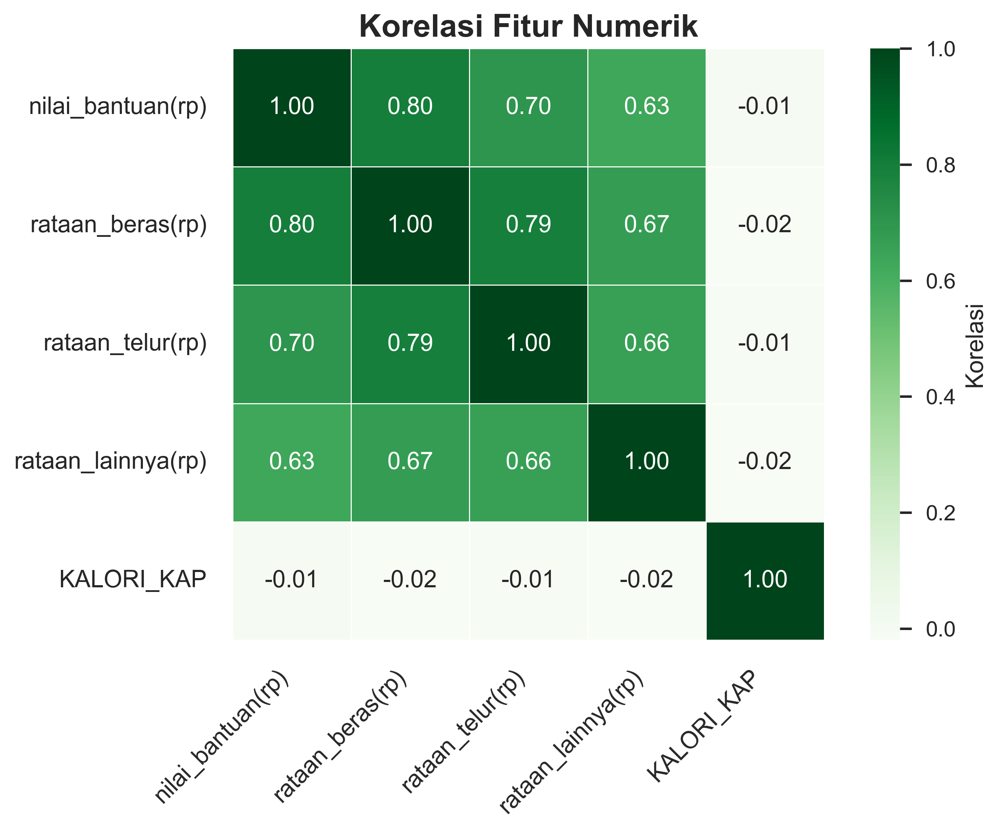

In [6]:
fitur_numerik = ['nilai_bantuan(rp)', 'rataan_beras(rp)', 'rataan_telur(rp)', 'rataan_lainnya(rp)', 'KALORI_KAP']
dfcorr = df_model[fitur_numerik]
corr = dfcorr.corr(method='pearson')
plt.figure(figsize=(8, 6))
sns.heatmap(
    corr, annot=True, fmt='.2f', cmap='Greens', cbar_kws={'label': 'Korelasi'},
    square=True, linewidths=0.5
)
plt.title("Korelasi Fitur Numerik", fontsize=16, fontweight='bold')
plt.xticks(rotation=45, ha='right', fontsize=12)
plt.yticks(rotation=0, fontsize=12)
plt.tight_layout()
plt.show()

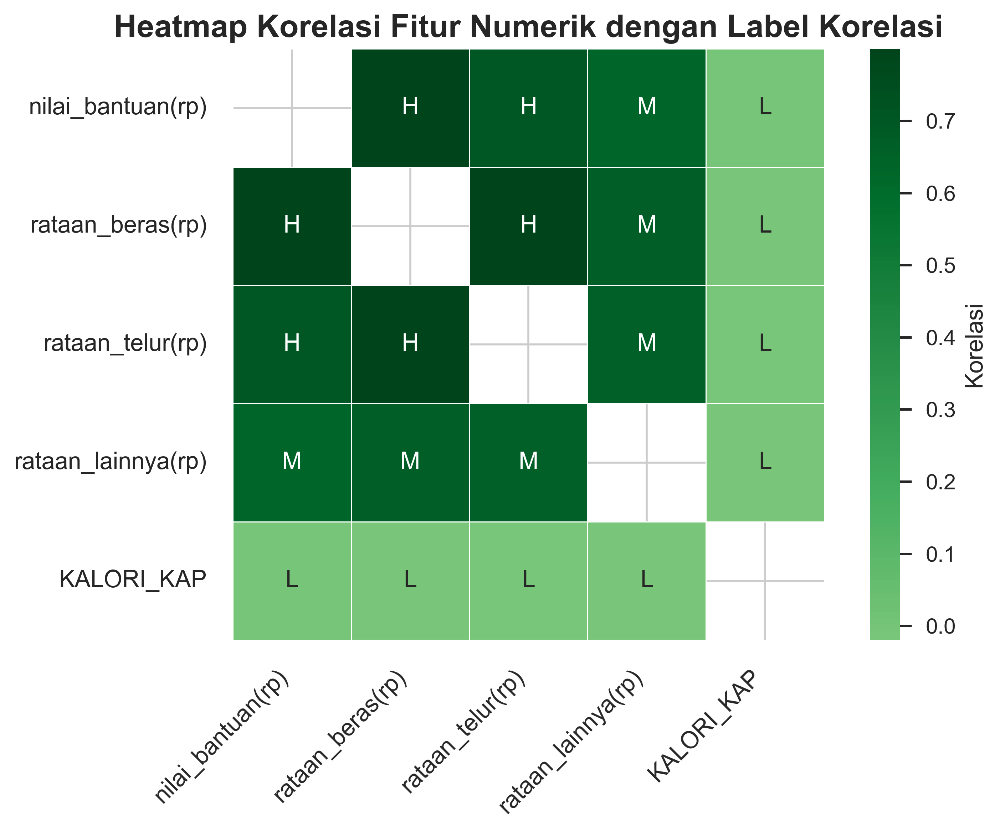

In [7]:
labels = np.where(abs(corr) > 0.7, 'H', np.where(abs(corr) >= 0.05, 'M', 'L'))
plt.figure(figsize=(8, 6))
sns.heatmap(
    corr, mask=np.eye(len(corr)), square=True, center=0, annot=labels,
    fmt='', cmap='Greens', cbar_kws={'label': 'Korelasi'}, linewidths=0.5
)

plt.title("Heatmap Korelasi Fitur Numerik dengan Label Korelasi", fontsize=16, fontweight='bold')
plt.xticks(rotation=45, ha='right', fontsize=12)
plt.yticks(rotation=0, fontsize=12)
plt.tight_layout()
plt.show()

### Boxplot IQR

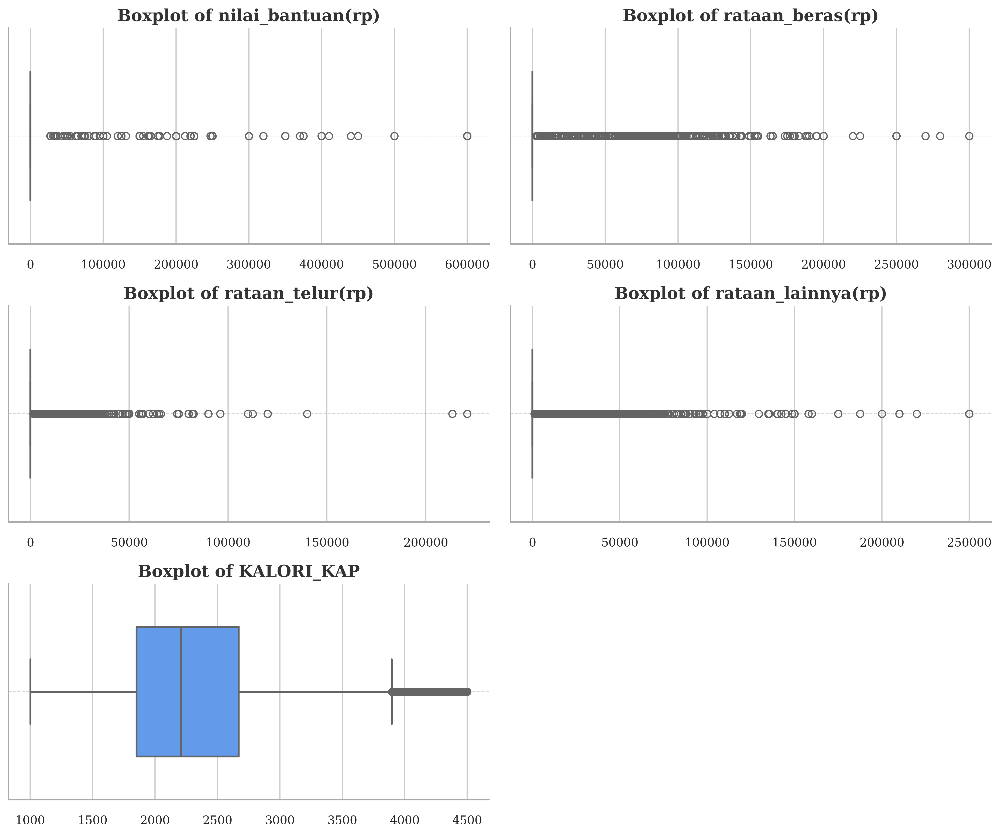

In [8]:
fitur_numerik = ['nilai_bantuan(rp)', 'rataan_beras(rp)', 'rataan_telur(rp)', 'rataan_lainnya(rp)', 'KALORI_KAP']

plt.figure(figsize=(12, 10)) 
for i, feature in enumerate(fitur_numerik, 1):
    plt.subplot(3, 2, i) 
    sns.boxplot(x=df_model[feature], color='#4D96FF', linewidth=1.5, width=0.6) 
    plt.title(f'Boxplot of {feature}', fontsize=14, fontweight='bold', family='serif', color='#333333')
    plt.xlabel("")  
    plt.xticks(fontsize=10, family='serif')  
    plt.yticks(fontsize=10, family='serif')  
    plt.grid(True, axis='y', linestyle='--', linewidth=0.7, alpha=0.5, color='#AAAAAA')  
    plt.gca().spines['top'].set_visible(False)
    plt.gca().spines['right'].set_visible(False)
    plt.gca().spines['left'].set_color('#AAAAAA')
    plt.gca().spines['bottom'].set_color('#AAAAAA')
plt.tight_layout()
plt.show()

### Histogram + Density Plot

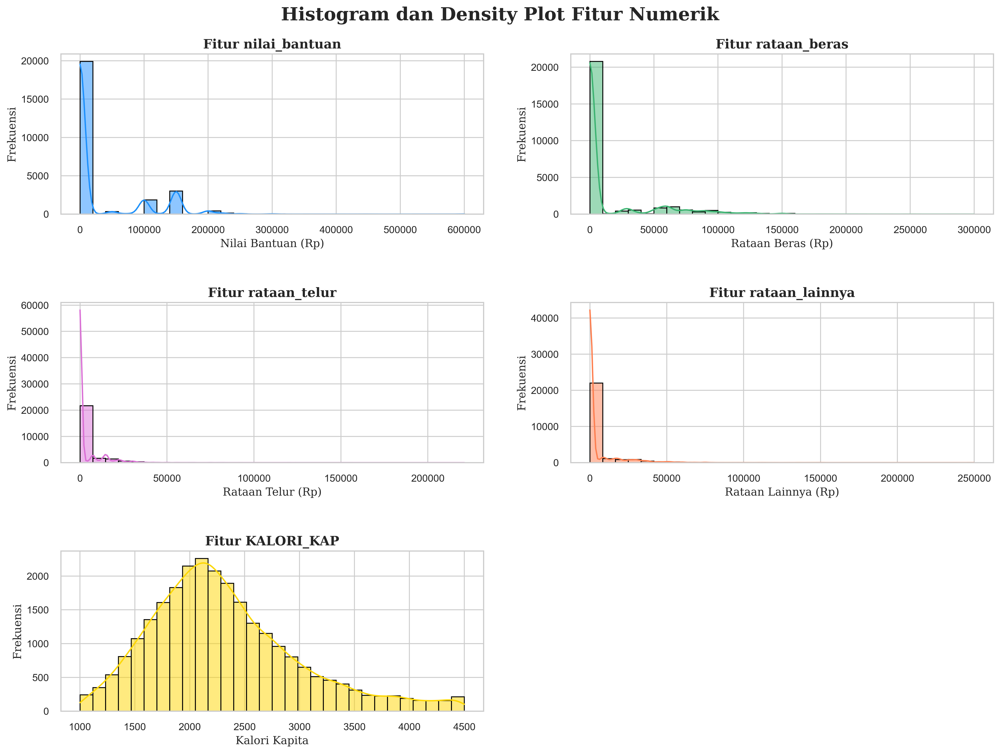

In [9]:
plt.figure(figsize=(16, 12))
sns.set_style("whitegrid")

# Histogram for 'nilai_bantuan(rp)'
plt.subplot(3, 2, 1)
sns.histplot(df_model["nilai_bantuan(rp)"], kde=True, color="dodgerblue", bins=30, edgecolor="black")
plt.title("Fitur nilai_bantuan", fontsize=14, fontweight='bold', family='serif')
plt.xlabel("Nilai Bantuan (Rp)", fontsize=12, family='serif')
plt.ylabel("Frekuensi", fontsize=12, family='serif')

# Histogram for 'rataan_beras(rp)'
plt.subplot(3, 2, 2)
sns.histplot(df_model["rataan_beras(rp)"], kde=True, color="mediumseagreen", bins=30, edgecolor="black")
plt.title("Fitur rataan_beras", fontsize=14, fontweight='bold', family='serif')
plt.xlabel("Rataan Beras (Rp)", fontsize=12, family='serif')
plt.ylabel("Frekuensi", fontsize=12, family='serif')

# Histogram for 'rataan_telur(rp)'
plt.subplot(3, 2, 3)
sns.histplot(df_model["rataan_telur(rp)"], kde=True, color="orchid", bins=30, edgecolor="black")
plt.title("Fitur rataan_telur", fontsize=14, fontweight='bold', family='serif')
plt.xlabel("Rataan Telur (Rp)", fontsize=12, family='serif')
plt.ylabel("Frekuensi", fontsize=12, family='serif')

# Histogram for 'rataan_lainnya(rp)'
plt.subplot(3, 2, 4)
sns.histplot(df_model["rataan_lainnya(rp)"], kde=True, color="coral", bins=30, edgecolor="black")
plt.title("Fitur rataan_lainnya", fontsize=14, fontweight='bold', family='serif')
plt.xlabel("Rataan Lainnya (Rp)", fontsize=12, family='serif')
plt.ylabel("Frekuensi", fontsize=12, family='serif')

# Histogram for 'KALORI_KAP'
plt.subplot(3, 2, 5)
sns.histplot(df_model["KALORI_KAP"], kde=True, color="gold", bins=30, edgecolor="black")
plt.title("Fitur KALORI_KAP", fontsize=14, fontweight='bold', family='serif')
plt.xlabel("Kalori Kapita", fontsize=12, family='serif')
plt.ylabel("Frekuensi", fontsize=12, family='serif')

plt.suptitle("Histogram dan Density Plot Fitur Numerik", fontsize=20, fontweight='bold', family='serif')
plt.tight_layout(pad=3)
plt.subplots_adjust(top=0.92)
plt.show()

### Pairplot

<Figure size 4000x3200 with 0 Axes>

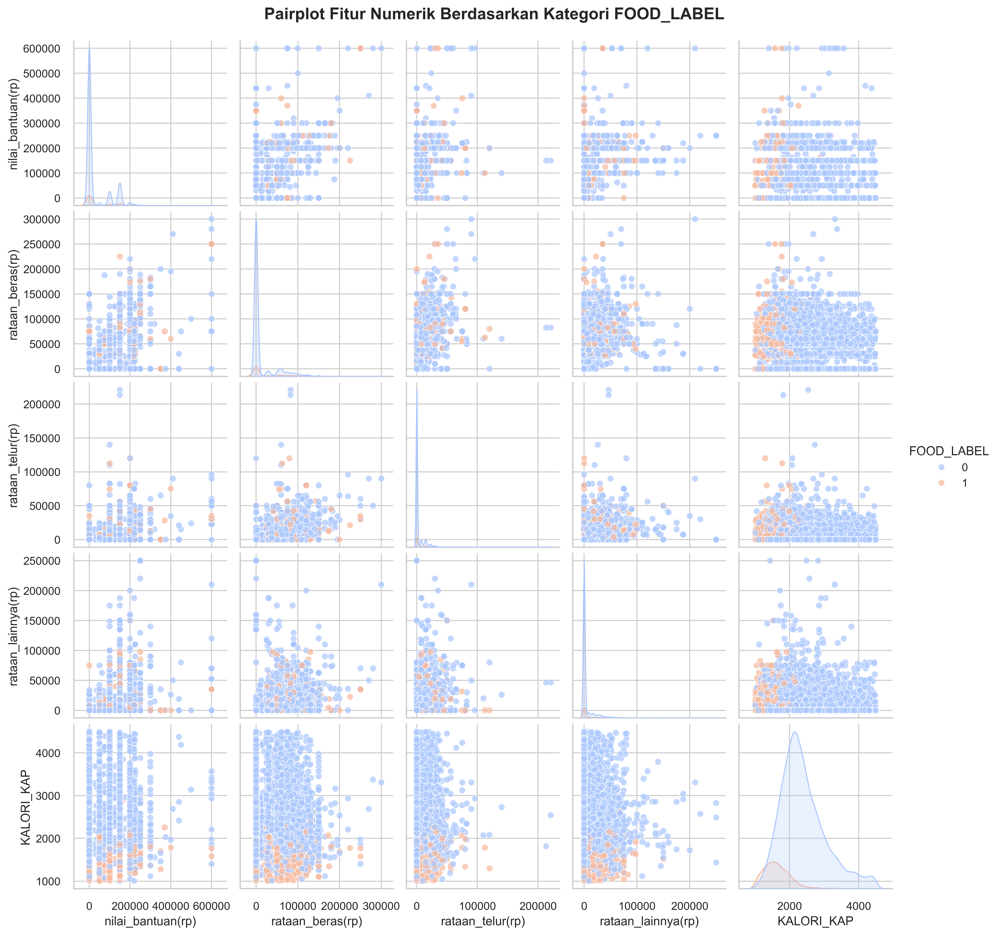

In [11]:
plt.figure(figsize=(10, 8))
sns.pairplot(df_model[fitur_numerik + ['FOOD_LABEL']], diag_kind='kde', height=2.5, hue='FOOD_LABEL', 
             palette='coolwarm', plot_kws={'alpha': 0.7, 's': 40}, diag_kws={'shade': True})
plt.suptitle("Pairplot Fitur Numerik Berdasarkan Kategori FOOD_LABEL", y=1.02, fontsize=16, fontweight='bold')
plt.show()

### Scatter Plot Y-X

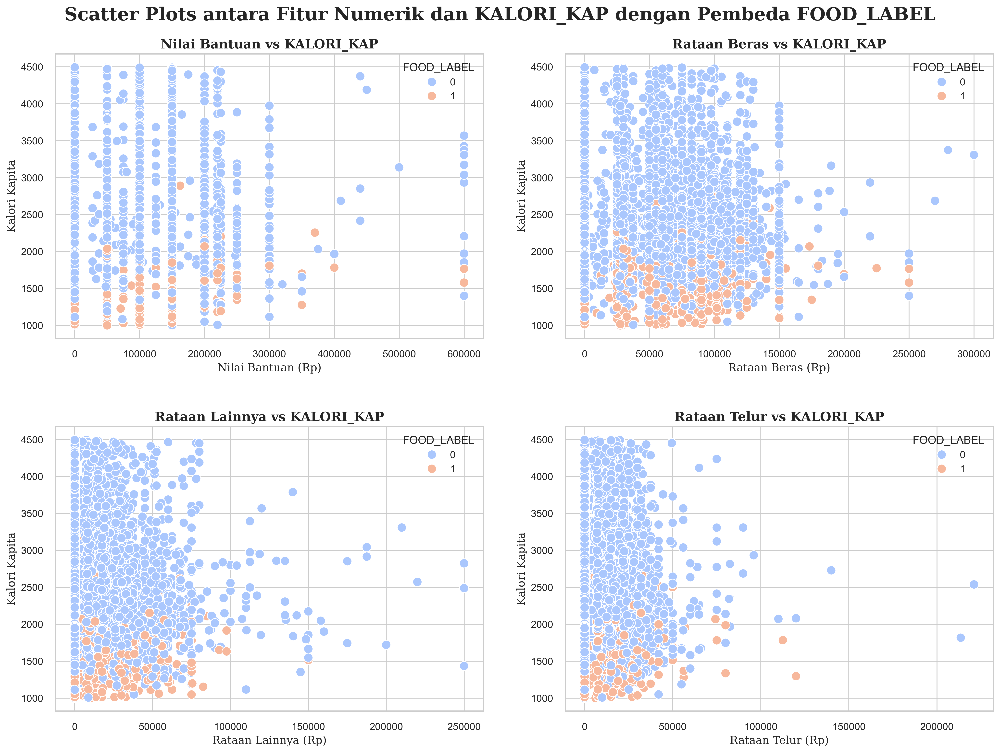

In [17]:
import seaborn as sns
import matplotlib.pyplot as plt

# Set the figure size and style
plt.figure(figsize=(16, 12))
sns.set_style("whitegrid")

# Scatter Plot 1: Nilai Bantuan vs KALORI_KAP
plt.subplot(2, 2, 1)
sns.scatterplot(data=df_model, x="nilai_bantuan(rp)", y="KALORI_KAP", hue="FOOD_LABEL", palette="coolwarm", s=100)
plt.title("Nilai Bantuan vs KALORI_KAP", fontsize=14, fontweight='bold', family='serif')
plt.xlabel("Nilai Bantuan (Rp)", fontsize=12, family='serif')
plt.ylabel("Kalori Kapita", fontsize=12, family='serif')

# Scatter Plot 2: Rataan Beras vs KALORI_KAP
plt.subplot(2, 2, 2)
sns.scatterplot(data=df_model, x="rataan_beras(rp)", y="KALORI_KAP", hue="FOOD_LABEL", palette="coolwarm", s=100)
plt.title("Rataan Beras vs KALORI_KAP", fontsize=14, fontweight='bold', family='serif')
plt.xlabel("Rataan Beras (Rp)", fontsize=12, family='serif')
plt.ylabel("Kalori Kapita", fontsize=12, family='serif')

# Scatter Plot 3: Rataan Lainnya vs KALORI_KAP
plt.subplot(2, 2, 3)
sns.scatterplot(data=df_model, x="rataan_lainnya(rp)", y="KALORI_KAP", hue="FOOD_LABEL", palette="coolwarm", s=100)
plt.title("Rataan Lainnya vs KALORI_KAP", fontsize=14, fontweight='bold', family='serif')
plt.xlabel("Rataan Lainnya (Rp)", fontsize=12, family='serif')
plt.ylabel("Kalori Kapita", fontsize=12, family='serif')

# Scatter Plot 4: Rataan Telur vs KALORI_KAP
plt.subplot(2, 2, 4)
sns.scatterplot(data=df_model, x="rataan_telur(rp)", y="KALORI_KAP", hue="FOOD_LABEL", palette="coolwarm", s=100)
plt.title("Rataan Telur vs KALORI_KAP", fontsize=14, fontweight='bold', family='serif')
plt.xlabel("Rataan Telur (Rp)", fontsize=12, family='serif')
plt.ylabel("Kalori Kapita", fontsize=12, family='serif')

# Title for all subplots
plt.suptitle("Scatter Plots antara Fitur Numerik dan KALORI_KAP dengan Pembeda FOOD_LABEL", fontsize=20, fontweight='bold', family='serif')

# Adjust layout for better display
plt.tight_layout(pad=3)
plt.subplots_adjust(top=0.92)

# Show the plot
plt.show()

## Kombinasi Kategorik-Numerik

### Boxplot - Numerik

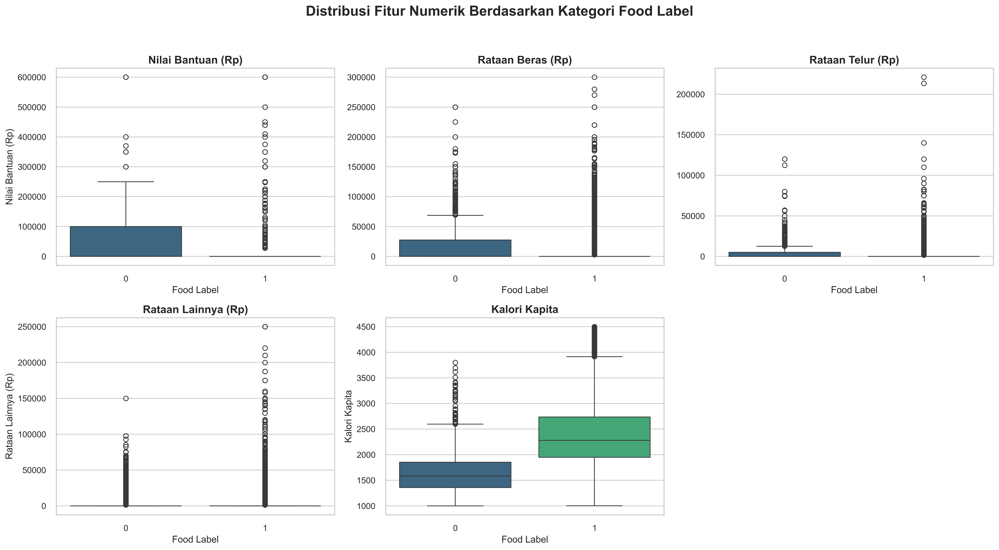

In [46]:
fig, axes = plt.subplots(2, 3, figsize=(18, 10))
fig.suptitle('Distribusi Fitur Numerik Berdasarkan Kategori Food Label', fontsize=18, fontweight='bold')

# Plot 1: nilai_bantuan(rp)
sns.boxplot(data=df_model, x='FOOD_LABEL', y='nilai_bantuan(rp)', palette='viridis', ax=axes[0, 0])
axes[0, 0].set_title('Nilai Bantuan (Rp)', fontsize=14, fontweight='bold')
axes[0, 0].set_xlabel('Food Label')
axes[0, 0].set_ylabel('Nilai Bantuan (Rp)')

# Plot 2: rataan_beras(rp)
sns.boxplot(data=df_model, x='FOOD_LABEL', y='rataan_beras(rp)', palette='viridis', ax=axes[0, 1])
axes[0, 1].set_title('Rataan Beras (Rp)', fontsize=14, fontweight='bold')
axes[0, 1].set_xlabel('Food Label')
axes[0, 1].set_ylabel('')

# Plot 3: rataan_telur(rp)
sns.boxplot(data=df_model, x='FOOD_LABEL', y='rataan_telur(rp)', palette='viridis', ax=axes[0, 2])
axes[0, 2].set_title('Rataan Telur (Rp)', fontsize=14, fontweight='bold')
axes[0, 2].set_xlabel('Food Label')
axes[0, 2].set_ylabel('')

# Plot 4: rataan_lainnya(rp)
sns.boxplot(data=df_model, x='FOOD_LABEL', y='rataan_lainnya(rp)', palette='viridis', ax=axes[1, 0])
axes[1, 0].set_title('Rataan Lainnya (Rp)', fontsize=14, fontweight='bold')
axes[1, 0].set_xlabel('Food Label')
axes[1, 0].set_ylabel('Rataan Lainnya (Rp)')

# Plot 5: KALORI_KAP
sns.boxplot(data=df_model, x='FOOD_LABEL', y='KALORI_KAP', palette='viridis', ax=axes[1, 1])
axes[1, 1].set_title('Kalori Kapita', fontsize=14, fontweight='bold')
axes[1, 1].set_xlabel('Food Label')
axes[1, 1].set_ylabel('Kalori Kapita')

fig.delaxes(axes[1, 2]) 
plt.tight_layout(rect=[0, 0, 1, 0.95]) 
plt.show()

## Kombinasi Kategorik- Kategorik

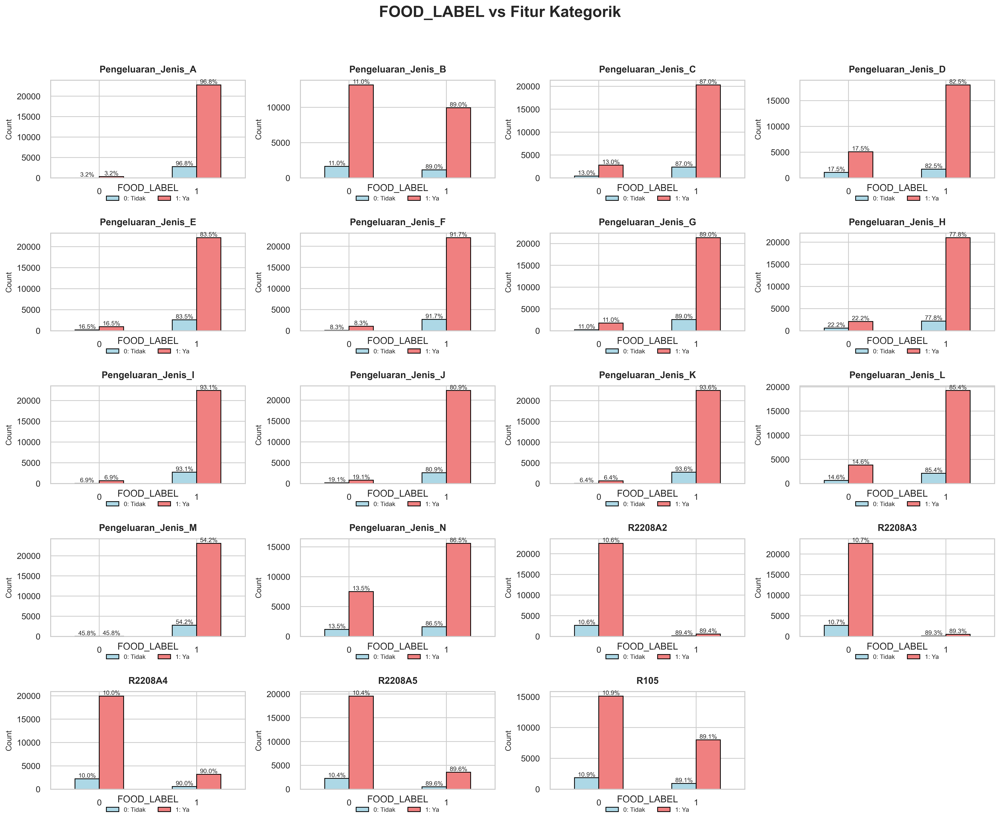

In [56]:
rows, cols = 5, 4
fig, axes = plt.subplots(rows, cols, figsize=(18, 15))
fig.suptitle('FOOD_LABEL vs Fitur Kategorik', fontsize=20, fontweight='bold')

for i, feature in enumerate(fitur_kategorik[1:]):
    row, col = divmod(i, cols)
    crosstab = pd.crosstab(df_model[feature], df_model['FOOD_LABEL'])
    percentages = crosstab.div(crosstab.sum(axis=1), axis=0) * 100 
    
    crosstab.plot(kind='bar', ax=axes[row, col], color=['lightblue', 'lightcoral'], edgecolor='black', legend=False)
    axes[row, col].set_title(feature, fontsize=12, fontweight='bold', pad=10)
    axes[row, col].set_xlabel("") 
    axes[row, col].set_ylabel('Count', fontsize=10, labelpad=5)
    axes[row, col].set_xticklabels(['0', '1'], rotation=0)
    
    for container in axes[row, col].containers:
        for bar, value in zip(container, percentages.values.flatten()):
            height = bar.get_height()
            if height > 0:
                axes[row, col].text(
                    bar.get_x() + bar.get_width() / 2,
                    height + 1,
                    f'{value:.1f}%',
                    ha='center',
                    va='bottom',
                    fontsize=8)

    axes[row, col].legend(
        ['0: Tidak', '1: Ya'], title='FOOD_LABEL', fontsize=8, loc='lower center', bbox_to_anchor=(0.5, -0.3), ncol=2
    )

for j in range(len(fitur_kategorik) - 1, rows * cols):
    fig.delaxes(axes[j // cols, j % cols])
plt.tight_layout(rect=[0, 0, 1, 0.95])
plt.show()